TASK 2

Customer Segementation of the premium egg consumers of GT

Clsutering using K-Means

In [536]:
#!pip install sqlalchemy
#!pip install --upgrade sqlalchemy snowflake-connector-python

In [552]:
import snowflake.connector
import pandas as pd
import smtplib
from email.mime.text import MIMEText
from email.mime.multipart import MIMEMultipart
from sqlalchemy import create_engine

In [553]:
import pandas as pd # dataframe manipulation
import numpy as np # linear algebra

# data visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns


# sklearn 
from sklearn.cluster import KMeans

from sklearn.metrics import silhouette_score, silhouette_samples, accuracy_score, classification_report

from yellowbrick.cluster import KElbowVisualizer


import snowflake.connector



In [554]:

# Snowflake credentials
username = 'Harshiteggoz'
password = 'Eggoz@123'
account = 'wt08714.ap-south-1.aws'
warehouse = 'COMPUTE_WH'
database = 'EGGOZDB'
schema = 'MAPLEMONK'


credentials = {
    'account': 'wt08714.ap-south-1.aws',
    'user': 'Harshiteggoz',
    'password': 'Eggoz@123',
    'database': 'GGOZDB',
    'schema': 'MAPLEMONK',
    'warehouse': 'COMPUTE_WH',
    
}

In [555]:
con = snowflake.connector.connect(
    account = credentials['account'],
    user = credentials['user'],
    password = credentials['password'],
    database = credentials['database'],
    schema = credentials['schema'],
    warehouse = credentials['warehouse'],

)

In [556]:
query = "USE EGGOZDB"

In [557]:
cur = con.cursor()
cur.execute(query)

In [558]:
# SQL query
query = """
    SELECT * 
    FROM eggozdb.maplemonk.darjan_sales_return_replace_promo_primary_and_secondary
    WHERE retailer_category = 'General Trader'
    AND product_type = 'Eggoz Premium'
    AND date BETWEEN '2023-01-01' AND CURRENT_DATE()
"""


In [559]:


# SQL query
query2 = """
   SELECT *
FROM eggozdb.maplemonk.my_sql_retailer_retailer
"""


In [560]:
cur.execute(query2)

In [561]:
table_df_2 = pd.read_sql_query(query2,con)

C:\Users\User\AppData\Local\Temp\ipykernel_6460\1111800908.py:1: UserWarning:

pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.



In [562]:
table_df_2.head()

,ID,CODE,GSTIN,BRAND,CITY_ID,ACCURACY,CODE_INT,IS_TRIAL,LATITUDE,PHONE_NO,...,INITIAL_WHITE_EGGS_POTENTIAL,BILLING_SHIPPING_ADDRESS_SAME,INITIAL_UNBRANDED_EGGS_POTENTIAL,_AIRBYTE_AB_ID,_AIRBYTE_EMITTED_AT,_AIRBYTE_NORMALIZED_AT,_AIRBYTE_MY_SQL_RETAILER_RETAILER_HASHID,RETAILER_CATEGORY,RETAILER_SUBCATEGORY,ACTIVITY_STATUS
0,8.0,G1240* alka mart 66,GSTIN,None,1.0,NaN,1240.0,False,NaN,+917452672417,...,0.0,True,0.0,945587c4-435d-47e3-b242-007e16b23ff9,2023-12-14 10:01:14.005000+00:00,2023-12-14 10:05:38.289000+00:00,42f96df0513a82d11979b015584457f4,General Trader,PICK AND GO SOCIETY,not_done
1,38.0,G1032* DAILY NEEDS palam vihar(Amit),GSTIN,None,1.0,NaN,1032.0,False,NaN,+919711282082,...,0.0,True,0.0,b4b54e49-cf80-43dd-950f-6dc7c8252d18,2023-12-14 10:01:14.005000+00:00,2023-12-14 10:05:38.289000+00:00,f79eeceb12308168d63007e8389a458b,General Trader,PICK AND GO MARKET,not_done
2,39.0,G1567* daily needs provision store,GSTIN,None,1.0,NaN,1567.0,False,NaN,+917899544854,...,0.0,True,0.0,c3481124-fcde-4cfe-b450-936b498491a2,2023-12-14 10:01:14.005000+00:00,2023-12-14 10:05:38.289000+00:00,b9d6a8619033f9c12f87a6b3bb7f710e,General Trader,PICK AND GO MARKET,not_done
3,11.0,G1105* ananya general store,GSTIN,None,1.0,NaN,1105.0,False,28.416566,+917134308478,...,0.0,True,0.0,24e1f5d3-a14a-486c-8719-ef0bac1c80fe,2023-12-14 10:01:14.005000+00:00,2023-12-14 10:05:38.289000+00:00,92affcbeb081fce0c301c8cb76c79c91,General Trader,PICK AND GO SOCIETY,not_done
4,2.0,G1164* 3D grocery store(Amit),GSTIN,None,1.0,NaN,1164.0,False,NaN,+919696700400,...,0.0,True,0.0,5b8a9595-00cc-401e-b031-eee341e15abd,2023-12-14 10:01:14.005000+00:00,2023-12-14 10:05:38.289000+00:00,25df9605864f4fd5196b912e238a0958,General Trader,PICK AND GO MARKET,not_done


In [563]:
table_df_2.columns

Index(['ID', 'CODE', 'GSTIN', 'BRAND', 'CITY_ID', 'ACCURACY', 'CODE_INT',
       'IS_TRIAL', 'LATITUDE', 'PHONE_NO', 'LONGITUDE', 'PARENT_ID',
       'RATE_TYPE', 'SECTOR_ID', 'CLUSTER_ID', 'IS_BLOCKED', 'APPROVED_AT',
       'BEAT_NUMBER', 'CATEGORY_ID', 'CODE_STRING', 'PROMOTER_ID',
       'RETAILER_ID', 'CREDIT_LIMIT', 'GSTIN_STATUS', 'NAME_OF_SHOP',
       'SOCIETY_NAME', 'GST_PHOTO_URL', 'APPROVED_BY_ID', 'DISTRIBUTOR_ID',
       'SALES_GSTIN_ID', 'SHOP_PHOTO_URL', 'GOOGLE_LOCATION',
       'LAST_ORDER_DATE', 'MERCHANDISER_ID', 'ONBOARDING_DATE',
       'RETAILERBEAT_ID', 'SUB_CATEGORY_ID', 'ANNUAL_INCOME_ID',
       'DISCOUNT_SLAB_ID', 'PAYMENT_CYCLE_ID', 'BEAT_ORDER_NUMBER',
       'CLASSIFICATION_ID', 'IS_PHONE_APPROVED', 'MARKETING_CLUSTER',
       'ONBOARDING_STATUS', 'BILLING_ADDRESS_ID', 'COMMISSION_SLAB_ID',
       'AREA_CLASSIFICATION', 'DISTRIBUTOR_EARNING', 'MIN_DISCOUNT_AMOUNT',
       'SHIPPING_ADDRESS_ID', 'BILLING_NAME_OF_SHOP', 'IS_LOCATION_ACCURATE',
       'IS_DI

In [565]:
table_df_2 = table_df_2[["RETAILER_ID","ONBOARDING_DATE",'ONBOARDING_STATUS',"MARKETING_CLUSTER"]]

In [566]:
#result_df_final_cluster = pd.merge(table_df_2, sum_df, on='RETAILER_ID', how='inner')

In [567]:
#result_df_final_cluster.to_csv("Final.csv",index=False)

In [568]:
#sum_df.head()

(27809, 17)

In [569]:
#sum_df.to_csv("Original_file.csv",index=False)

In [570]:
#result_df_final_cluster.shape

In [571]:
#result_df_final_cluster.nunique()

In [572]:
#sum_df.nunique()

In [ ]:
#table_df_2.nunique()

RETAILER_ID          9904
ONBOARDING_DATE      8287
ONBOARDING_STATUS       9
MARKETING_CLUSTER     153
dtype: int64

In [573]:
#sum_df.nunique()

In [480]:
#sum_df.shape

(27809, 17)

In [479]:
#result_df_final_cluster.shape

(17824, 20)

In [315]:
# Perform a left join on RETAILER_ID
#result_df_final_2 = pd.merge(table_df_2, result_df, on='RETAILER_ID', how='left')

In [574]:
#result_df_final_2.columns

In [293]:
#result_df_final_2.to_csv("final_data_cluster_2.csv",index=False)

In [275]:
#result_df_final[result_df_final["cluster_label"]==0]

In [575]:

cur.execute(query)


In [576]:
table_df = pd.read_sql_query(query,con)

C:\Users\User\AppData\Local\Temp\ipykernel_6460\2597221557.py:1: UserWarning:

pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.



In [577]:
table_df['DATE']=pd.to_datetime(table_df['DATE'])

In [578]:
table_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99075 entries, 0 to 99074
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   RETAILER_NAME           99075 non-null  object        
 1   ONBOARDING_STATUS       99075 non-null  object        
 2   DATE                    99075 non-null  datetime64[ns]
 3   QUANTITY                99075 non-null  float64       
 4   SKU_ORDER_PRICE_AMOUNT  99075 non-null  float64       
 5   NET_SALE                99075 non-null  float64       
 6   PARENT_RETAILER_NAME    2841 non-null   object        
 7   AREA_CLASSIFICATION     99075 non-null  object        
 8   CITY_NAME               99075 non-null  object        
 9   BEAT_NUMBER             99075 non-null  float64       
 10  BEAT_NUMBER_OPERATIONS  88608 non-null  float64       
 11  BRAND_TYPE              83252 non-null  object        
 12  ORDER_PRICE_AMOUNT      83252 non-null  float6

In [579]:


# Perform a left join on RETAILER_ID
#result_df = pd.merge(table_df, sum_df_new, on='RETAILER_ID', how='left')



In [580]:
'''result_df=result_df[['RETAILER_NAME','DATE', 'QUANTITY',
       'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE', 'PARENT_RETAILER_NAME',
       'AREA_CLASSIFICATION', 'CITY_NAME', 'BEAT_NUMBER',
       'BEAT_NUMBER_OPERATIONS', 'BRAND_TYPE', 'ORDER_PRICE_AMOUNT',
       'SKU_RETURN_AMOUNT', 'SKU_COUNT', 'SHORT_NAME', 'SKU', 'PRODUCT_TYPE',
       'PRODUCT_NAME', 'RETURN_EGGS', 'REPLACED_EGGS', 'PROMO_EGGS',
       'SINGLE_SKU_RATE', 'EGGS', 'RETAILER_CATEGORY', 'SALE_TYPE',
       'RETAILER_ID', 'DISTRIBUTOR_ID', 'DISTRIBUTOR', 'cluster_label']]'''

"result_df=result_df[['RETAILER_NAME','DATE', 'QUANTITY',\n       'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE', 'PARENT_RETAILER_NAME',\n       'AREA_CLASSIFICATION', 'CITY_NAME', 'BEAT_NUMBER',\n       'BEAT_NUMBER_OPERATIONS', 'BRAND_TYPE', 'ORDER_PRICE_AMOUNT',\n       'SKU_RETURN_AMOUNT', 'SKU_COUNT', 'SHORT_NAME', 'SKU', 'PRODUCT_TYPE',\n       'PRODUCT_NAME', 'RETURN_EGGS', 'REPLACED_EGGS', 'PROMO_EGGS',\n       'SINGLE_SKU_RATE', 'EGGS', 'RETAILER_CATEGORY', 'SALE_TYPE',\n       'RETAILER_ID', 'DISTRIBUTOR_ID', 'DISTRIBUTOR', 'cluster_label']]"

In [582]:
#result_df.head()

In [583]:
table_df = table_df.sort_values('DATE')

______________________________________________________________________________________________________________________________________________________________________________________

In [584]:
table_df[table_df["SKU"]=="6W"][["QUANTITY","NET_SALE","SKU_ORDER_PRICE_AMOUNT","SKU_RETURN_AMOUNT","RETURN_EGGS","REPLACED_EGGS","SINGLE_SKU_RATE","SKU","EGGS"]]

,QUANTITY,NET_SALE,SKU_ORDER_PRICE_AMOUNT,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,SINGLE_SKU_RATE,SKU,EGGS
59003,6.0,331.32,396.0,64.68,6.0,0.0,66.0,6W,36.0
79391,0.0,0.00,0.0,0.00,0.0,18.0,0.0,6W,0.0
13962,2.0,132.00,132.0,0.00,0.0,0.0,66.0,6W,12.0
274,0.0,0.00,0.0,0.00,0.0,12.0,0.0,6W,0.0
27529,2.0,126.00,126.0,0.00,0.0,0.0,63.0,6W,12.0
...,...,...,...,...,...,...,...,...,...
8871,5.0,352.50,352.5,0.00,0.0,0.0,70.5,6W,30.0
29649,2.0,131.60,131.6,0.00,0.0,0.0,65.8,6W,12.0
67405,3.0,211.50,211.5,0.00,0.0,0.0,70.5,6W,18.0
84513,4.0,244.40,244.4,0.00,0.0,0.0,61.1,6W,24.0


# Why single SKU Rate for 6W changes when the quantity is changing from 2 to 3 to 10 and not fixed even if the eggs are same

## ____________________________________________________________________________________________________________________________________________________________________________________

Inference on Area classification column

In [585]:
import plotly.express as px

# Assuming your DataFrame is 'sum_df'
fig = px.histogram(table_df, x='AREA_CLASSIFICATION', title='Count Plot of Retailers by Area')
fig.update_layout(xaxis_title='Area', yaxis_title='Count')

fig.show()


 Most of the retailers are from Noida, Delhi, Gurgaon, Bangalore and Indore
 DELHI has the highest number of retailers of eggoz

 --------------------------------------------------------------------------------------------

In [586]:
import plotly.express as px

# Assuming your DataFrame is 'sum_df'
fig = px.histogram(table_df, x='SKU', title='Count Plot of Retailers by SKU Category')
fig.update_layout(xaxis_title='SKU Category', yaxis_title='Count')

fig.show()


# Rank of sales 

10W has highest sales and strategies need to be made to increase the sales of 10N, 30W,30B and also measures  need to be taken to improve the sales of 10W, 25W, 6W AND 10B, 25B.

-------------------------------------------------------------------------------

In [329]:
import plotly.express as px

# Assuming your DataFrame is 'sum_df'
fig = px.histogram(table_df, x='SALE_TYPE', title='Count Plot of Retailers by SKU Category')
fig.update_layout(xaxis_title='SKU Category', yaxis_title='Count')

fig.show()


The secondary sales are huge as comapared to primary sales. The reason may be beca............

---------------------------------------------------------------------------------------

In [587]:
table_df.columns

Index(['RETAILER_NAME', 'ONBOARDING_STATUS', 'DATE', 'QUANTITY',
       'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE', 'PARENT_RETAILER_NAME',
       'AREA_CLASSIFICATION', 'CITY_NAME', 'BEAT_NUMBER',
       'BEAT_NUMBER_OPERATIONS', 'BRAND_TYPE', 'ORDER_PRICE_AMOUNT',
       'SKU_RETURN_AMOUNT', 'SKU_COUNT', 'SHORT_NAME', 'SKU', 'PRODUCT_TYPE',
       'PRODUCT_NAME', 'RETURN_EGGS', 'REPLACED_EGGS', 'PROMO_EGGS',
       'SINGLE_SKU_RATE', 'EGGS', 'RETAILER_CATEGORY', 'SALE_TYPE',
       'RETAILER_ID', 'DISTRIBUTOR_ID', 'DISTRIBUTOR'],
      dtype='object')

In [588]:
table_df.head()

,RETAILER_NAME,ONBOARDING_STATUS,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,PARENT_RETAILER_NAME,AREA_CLASSIFICATION,CITY_NAME,BEAT_NUMBER,...,RETURN_EGGS,REPLACED_EGGS,PROMO_EGGS,SINGLE_SKU_RATE,EGGS,RETAILER_CATEGORY,SALE_TYPE,RETAILER_ID,DISTRIBUTOR_ID,DISTRIBUTOR
67214,N4425* Mother dairy{830},Cold,2023-01-01,6.0,654.0,654.00,None,Noida-GT,Noida,1201.0,...,0.0,0.0,0.0,109.0,60.0,General Trader,Primary_Sale,3728.0,7984.0,N4820* P.s daily needz
59003,N4139* KC Departmental store (75 Noida),Cold,2023-01-01,6.0,396.0,331.32,None,Noida-GT,Noida,1222.0,...,6.0,0.0,0.0,66.0,36.0,General Trader,Primary_Sale,2343.0,5958.0,N4623* M/S SAMPOORAN MARKETING
82124,D2612* Mother dairy 140,Active,2023-01-01,7.0,658.0,658.00,None,Delhi-GT,Delhi,1107.0,...,0.0,0.0,0.0,94.0,70.0,General Trader,Primary_Sale,1502.0,NaN,None
92010,D2279* Green Chick Chop Vasant Kunj (ABHI),Active,2023-01-01,4.0,844.0,844.00,GREEN CHIK CHOP,Delhi-GT,Delhi,1101.0,...,0.0,0.0,0.0,211.0,100.0,General Trader,Primary_Sale,430.0,NaN,None
22714,D2728* Sardar Meat Shop - Near gurunanak Shop,Cold,2023-01-01,1.0,135.0,135.00,None,Delhi-GT,Delhi,5002.0,...,0.0,0.0,0.0,135.0,10.0,General Trader,Secondary_Sale,1729.0,5907.0,D3770* PRIPA ENTERPRISES (NORTH DELHI DISTRIBU...


In [589]:
table_df.columns

Index(['RETAILER_NAME', 'ONBOARDING_STATUS', 'DATE', 'QUANTITY',
       'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE', 'PARENT_RETAILER_NAME',
       'AREA_CLASSIFICATION', 'CITY_NAME', 'BEAT_NUMBER',
       'BEAT_NUMBER_OPERATIONS', 'BRAND_TYPE', 'ORDER_PRICE_AMOUNT',
       'SKU_RETURN_AMOUNT', 'SKU_COUNT', 'SHORT_NAME', 'SKU', 'PRODUCT_TYPE',
       'PRODUCT_NAME', 'RETURN_EGGS', 'REPLACED_EGGS', 'PROMO_EGGS',
       'SINGLE_SKU_RATE', 'EGGS', 'RETAILER_CATEGORY', 'SALE_TYPE',
       'RETAILER_ID', 'DISTRIBUTOR_ID', 'DISTRIBUTOR'],
      dtype='object')

In [590]:
table_df.nunique()

RETAILER_NAME              2806
ONBOARDING_STATUS             7
DATE                        348
QUANTITY                     54
SKU_ORDER_PRICE_AMOUNT     1437
NET_SALE                   2079
PARENT_RETAILER_NAME          4
AREA_CLASSIFICATION          10
CITY_NAME                    12
BEAT_NUMBER                 119
BEAT_NUMBER_OPERATIONS       86
BRAND_TYPE                    1
ORDER_PRICE_AMOUNT        10734
SKU_RETURN_AMOUNT           531
SKU_COUNT                     4
SHORT_NAME                    3
SKU                           9
PRODUCT_TYPE                  1
PRODUCT_NAME                  3
RETURN_EGGS                  42
REPLACED_EGGS                57
PROMO_EGGS                   39
SINGLE_SKU_RATE             186
EGGS                        110
RETAILER_CATEGORY             1
SALE_TYPE                     2
RETAILER_ID                2806
DISTRIBUTOR_ID               25
DISTRIBUTOR                  25
dtype: int64

In [591]:
table_df[(table_df["SKU_ORDER_PRICE_AMOUNT"]-table_df["SKU_RETURN_AMOUNT"])!=table_df["NET_SALE"]]

,RETAILER_NAME,ONBOARDING_STATUS,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,PARENT_RETAILER_NAME,AREA_CLASSIFICATION,CITY_NAME,BEAT_NUMBER,...,RETURN_EGGS,REPLACED_EGGS,PROMO_EGGS,SINGLE_SKU_RATE,EGGS,RETAILER_CATEGORY,SALE_TYPE,RETAILER_ID,DISTRIBUTOR_ID,DISTRIBUTOR


In [592]:
table_df.isna().sum()

RETAILER_NAME                 0
ONBOARDING_STATUS             0
DATE                          0
QUANTITY                      0
SKU_ORDER_PRICE_AMOUNT        0
NET_SALE                      0
PARENT_RETAILER_NAME      96234
AREA_CLASSIFICATION           0
CITY_NAME                     0
BEAT_NUMBER                   0
BEAT_NUMBER_OPERATIONS    10467
BRAND_TYPE                15823
ORDER_PRICE_AMOUNT        15823
SKU_RETURN_AMOUNT             0
SKU_COUNT                     0
SHORT_NAME                    0
SKU                           0
PRODUCT_TYPE                  0
PRODUCT_NAME                  0
RETURN_EGGS                   0
REPLACED_EGGS                 0
PROMO_EGGS                    0
SINGLE_SKU_RATE               0
EGGS                          0
RETAILER_CATEGORY             0
SALE_TYPE                     0
RETAILER_ID                   0
DISTRIBUTOR_ID            15182
DISTRIBUTOR               15182
dtype: int64

In [593]:
#table_df.drop(['RETAILER_NAME','PARENT_RETAILER_NAME','BEAT_NUMBER_OPERATIONS','BRAND_TYPE','DISTRIBUTOR_ID','DISTRIBUTOR'],axis=1, inplace=True)

In [594]:
columns =[ 'DATE', 'QUANTITY',
       'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
      'SKU_RETURN_AMOUNT',   'RETURN_EGGS', 'REPLACED_EGGS', 
        'EGGS',
       'RETAILER_ID']

In [595]:
table_df=table_df[columns]
table_df= table_df.reset_index()
table_df.drop('index',axis=1,inplace=True)

In [596]:
table_df.nunique()

DATE                       348
QUANTITY                    54
SKU_ORDER_PRICE_AMOUNT    1437
NET_SALE                  2079
SKU_RETURN_AMOUNT          531
RETURN_EGGS                 42
REPLACED_EGGS               57
EGGS                       110
RETAILER_ID               2806
dtype: int64

In [597]:
table_df.head(10)

,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,RETAILER_ID
0,2023-01-01,6.0,654.0,654.00,0.00,0.0,0.0,60.0,3728.0
1,2023-01-01,6.0,396.0,331.32,64.68,6.0,0.0,36.0,2343.0
2,2023-01-01,7.0,658.0,658.00,0.00,0.0,0.0,70.0,1502.0
3,2023-01-01,4.0,844.0,844.00,0.00,0.0,0.0,100.0,430.0
4,2023-01-01,1.0,135.0,135.00,0.00,0.0,0.0,10.0,1729.0
5,2023-01-01,3.0,651.0,651.00,0.00,0.0,50.0,75.0,872.0
6,2023-01-01,0.0,0.0,0.00,0.00,0.0,75.0,0.0,926.0
7,2023-01-01,0.0,0.0,0.00,0.00,0.0,25.0,0.0,2062.0
8,2023-01-01,1.0,109.0,109.00,0.00,0.0,0.0,10.0,5294.0
9,2023-01-01,0.0,0.0,0.00,0.00,0.0,18.0,0.0,3306.0


In [598]:
table_df.columns

Index(['DATE', 'QUANTITY', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'RETAILER_ID'],
      dtype='object')

In [599]:
# Extract week information from the 'DATE' column
table_df['Week'] = table_df['DATE'].dt.isocalendar().week

In [600]:
table_df.tail(40000)

,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,RETAILER_ID,Week
59075,2023-08-08,8.0,1860.0,1860.0,0.0,0.0,0.0,200.0,6068.0,32
59076,2023-08-08,10.0,1087.5,1087.5,0.0,0.0,10.0,100.0,1595.0,32
59077,2023-08-08,0.0,0.0,0.0,0.0,0.0,30.0,0.0,2435.0,32
59078,2023-08-08,6.0,591.6,591.6,0.0,0.0,0.0,60.0,2199.0,32
59079,2023-08-08,10.0,942.5,942.5,0.0,0.0,0.0,100.0,6054.0,32
...,...,...,...,...,...,...,...,...,...,...
99070,2023-12-14,4.0,244.4,244.4,0.0,0.0,0.0,24.0,1201.0,50
99071,2023-12-14,5.0,675.0,675.0,0.0,0.0,0.0,50.0,8242.0,50
99072,2023-12-14,4.0,282.0,282.0,0.0,0.0,0.0,24.0,3125.0,50
99073,2023-12-14,3.0,405.0,405.0,0.0,0.0,0.0,30.0,3125.0,50


In [601]:
table_df[table_df["RETAILER_ID"]==2253]["Week"]

61       52
119      52
1702      1
2880      1
4581      2
8002      3
8052      3
11388     5
12300     5
12344     5
Name: Week, dtype: UInt32

In [602]:
table_df.columns

Index(['DATE', 'QUANTITY', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'RETAILER_ID', 'Week'],
      dtype='object')

Important

In [603]:
table_df[(table_df["RETAILER_ID"]==1521.0)& (table_df["Week"]==1)][["DATE","RETAILER_ID","EGGS","Week"]]

,DATE,RETAILER_ID,EGGS,Week
250,2023-01-02,1521.0,100.0,1
275,2023-01-02,1521.0,0.0,1
345,2023-01-02,1521.0,70.0,1
435,2023-01-02,1521.0,550.0,1
461,2023-01-02,1521.0,20.0,1
558,2023-01-03,1521.0,10.0,1
590,2023-01-03,1521.0,18.0,1
682,2023-01-03,1521.0,70.0,1
687,2023-01-03,1521.0,450.0,1
998,2023-01-04,1521.0,850.0,1


In [604]:
# Group by 'RETAILER_ID' and 'Week'
grouped_df = table_df.groupby(['RETAILER_ID', 'Week'])

# Display the data for each group
for group, data in grouped_df:
    
   
    if data.shape[0]>3:
        print(data)
        break    

           DATE  QUANTITY  SKU_ORDER_PRICE_AMOUNT  NET_SALE  \
6267 2023-01-17       5.0                   520.0     520.0   
6325 2023-01-17       5.0                  1115.0    1115.0   
6328 2023-01-17       3.0                   390.0     390.0   
7745 2023-01-21       5.0                   520.0     520.0   

      SKU_RETURN_AMOUNT  RETURN_EGGS  REPLACED_EGGS   EGGS  RETAILER_ID  Week  
6267                0.0          0.0            0.0   50.0          7.0     3  
6325                0.0          0.0            0.0  125.0          7.0     3  
6328                0.0          0.0            0.0   30.0          7.0     3  
7745                0.0          0.0            0.0   50.0          7.0     3  


In [605]:
# List of columns to sum for each retailer and week
columns_to_sum = ['SKU_ORDER_PRICE_AMOUNT', 'NET_SALE', 'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS']

# Group by 'RETAILER_ID' and 'Week' and calculate the sum of specified columns
# Add a new column 'FREQUENCY_RETAILER_WEEK' to count the number of unique dates in each group
sum_df = table_df.groupby(['RETAILER_ID', 'Week']).agg({
    **{col: 'sum' for col in columns_to_sum},
    'DATE': 'nunique',  # Count the number of unique dates
}).reset_index()

# Rename the 'DATE' column to 'FREQUENCY_RETAILER_WEEK'
sum_df = sum_df.rename(columns={'DATE': 'FREQUENCY_RETAILER_WEEK'})

# Print the updated DataFrame
sum_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK
0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1
1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2
2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1
3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2
4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1


In [606]:
table_df[table_df["RETAILER_ID"]==1][["DATE","Week"]]

,DATE,Week
1539,2023-01-05,1
1700,2023-01-05,1
3333,2023-01-09,2
3529,2023-01-09,2
4848,2023-01-13,2
6966,2023-01-19,3
7091,2023-01-19,3
8422,2023-01-24,4
9780,2023-01-29,4
11382,2023-02-02,5


In [607]:
sum_df[sum_df["FREQUENCY_RETAILER_WEEK"]==6]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK
8626,1521.0,5,35481.0,34987.0,494.0,50.0,280.0,3946.0,6
19192,5612.0,8,23989.0,23248.0,741.0,75.0,150.0,2650.0,6
22888,6974.0,38,26464.0,23544.4,2919.6,304.0,0.0,2320.0,6


In [608]:
table_df[(table_df["RETAILER_ID"]==1521)& (table_df["Week"]==5)]

,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,RETAILER_ID,Week
10152,2023-01-30,0.0,0.0,0.0,0.0,0.0,75.0,0.0,1521.0,5
10306,2023-01-30,0.0,0.0,0.0,0.0,0.0,25.0,0.0,1521.0,5
10458,2023-01-30,0.0,0.0,0.0,0.0,0.0,10.0,0.0,1521.0,5
10526,2023-01-31,10.0,940.0,940.0,0.0,0.0,0.0,100.0,1521.0,5
10627,2023-01-31,19.0,4693.0,4693.0,0.0,0.0,0.0,475.0,1521.0,5
10643,2023-01-31,22.0,4444.0,4444.0,0.0,0.0,0.0,550.0,1521.0,5
10856,2023-01-31,10.0,570.0,570.0,0.0,0.0,0.0,60.0,1521.0,5
11268,2023-02-02,0.0,0.0,0.0,0.0,0.0,20.0,0.0,1521.0,5
11493,2023-02-02,6.0,702.0,702.0,0.0,0.0,0.0,60.0,1521.0,5
11500,2023-02-02,3.0,303.0,303.0,0.0,0.0,0.0,30.0,1521.0,5


In [609]:
table_df[(table_df["RETAILER_ID"]==6974)& (table_df["Week"]==38)]

,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,RETAILER_ID,Week
72388,2023-09-18,50.0,5800.0,5800.0,0.0,0.0,0.0,500.0,6974.0,38
72421,2023-09-18,50.0,3520.0,3520.0,0.0,0.0,0.0,300.0,6974.0,38
72436,2023-09-18,10.0,1440.0,1440.0,0.0,0.0,0.0,100.0,6974.0,38
72566,2023-09-19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6974.0,38
73346,2023-09-21,32.0,7936.0,7936.0,0.0,0.0,0.0,800.0,6974.0,38
73404,2023-09-21,0.0,0.0,-1551.2,1551.2,168.0,0.0,0.0,6974.0,38
73465,2023-09-21,0.0,0.0,-1313.0,1313.0,130.0,0.0,0.0,6974.0,38
73875,2023-09-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6974.0,38
74077,2023-09-23,20.0,2880.0,2880.0,0.0,0.0,0.0,200.0,6974.0,38
74347,2023-09-23,30.0,3480.0,3480.0,0.0,0.0,0.0,300.0,6974.0,38


In [610]:
sum_df["FREQUENCY_RETAILER_WEEK"].unique()

array([1, 2, 4, 3, 5, 6], dtype=int64)

In [611]:
table_df[table_df['RETAILER_ID']==1800]

,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,RETAILER_ID,Week
1520,2023-01-05,3.0,312.00,312.00,0.0,0.0,0.0,30.0,1800.0,1
1664,2023-01-05,4.0,252.00,252.00,0.0,0.0,0.0,24.0,1800.0,1
1848,2023-01-05,2.0,446.00,446.00,0.0,0.0,0.0,50.0,1800.0,1
3543,2023-01-10,3.0,189.00,189.00,0.0,0.0,0.0,18.0,1800.0,2
3589,2023-01-10,3.0,312.00,312.00,0.0,0.0,0.0,30.0,1800.0,2
...,...,...,...,...,...,...,...,...,...,...
88908,2023-11-08,3.0,348.75,348.75,0.0,0.0,0.0,30.0,1800.0,45
88922,2023-11-08,0.0,0.00,0.00,0.0,0.0,25.0,0.0,1800.0,45
95053,2023-11-30,2.0,141.00,141.00,0.0,0.0,0.0,12.0,1800.0,48
96207,2023-12-03,3.0,751.50,751.50,0.0,0.0,0.0,75.0,1800.0,48


In [612]:
table_df.columns

Index(['DATE', 'QUANTITY', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'RETAILER_ID', 'Week'],
      dtype='object')

In [613]:
table_df.head()

,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,RETAILER_ID,Week
0,2023-01-01,6.0,654.0,654.00,0.00,0.0,0.0,60.0,3728.0,52
1,2023-01-01,6.0,396.0,331.32,64.68,6.0,0.0,36.0,2343.0,52
2,2023-01-01,7.0,658.0,658.00,0.00,0.0,0.0,70.0,1502.0,52
3,2023-01-01,4.0,844.0,844.00,0.00,0.0,0.0,100.0,430.0,52
4,2023-01-01,1.0,135.0,135.00,0.00,0.0,0.0,10.0,1729.0,52


In [614]:
sum_df[sum_df['RETAILER_ID']==1800]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK
10304,1800.0,1,1010.00,1010.00,0.0,0.0,0.0,104.0,1
10305,1800.0,2,1439.00,1439.00,0.0,0.0,0.0,128.0,1
10306,1800.0,3,2387.00,2387.00,0.0,0.0,0.0,225.0,1
10307,1800.0,5,3023.00,3023.00,0.0,0.0,35.0,271.0,3
10308,1800.0,7,312.00,312.00,0.0,0.0,117.0,30.0,1
10309,1800.0,8,446.00,446.00,0.0,0.0,30.0,50.0,2
10310,1800.0,9,943.20,943.20,0.0,0.0,50.0,90.0,1
10311,1800.0,10,398.88,398.88,0.0,0.0,20.0,38.0,1
10312,1800.0,11,0.00,0.00,0.0,0.0,75.0,0.0,1
10313,1800.0,14,4501.26,4501.26,0.0,0.0,0.0,422.0,3


In [615]:
sum_df.shape

(31584, 9)

In [616]:

# Assuming sum_df is your DataFrame
for i in range(len(sum_df)):
    if sum_df.loc[i, "REPLACED_EGGS"] + sum_df.loc[i, "RETURN_EGGS"] == 0:
        sum_df.loc[i, "ret+rep%"] = 0
    elif sum_df.loc[i, "EGGS"] == 0:
        # Drop the record if EGGS is zero
        sum_df = sum_df.drop(i)
    else:
        # Calculate percentage and add to "ret+rep%" column
        sum_df.loc[i, "ret+rep%"] = (sum_df.loc[i, "REPLACED_EGGS"] + sum_df.loc[i, "RETURN_EGGS"]) / sum_df.loc[i, "EGGS"]

# Reset index after dropping rows
sum_df = sum_df.reset_index(drop=True)


In [617]:
# New column: net_Sale divided by (eggs - return_eggs)
sum_df['Landing Price'] = sum_df['NET_SALE'] / (sum_df['EGGS'] - sum_df['RETURN_EGGS'])

In [618]:

# Calculate the age of each retailer in terms of distinct weeks
age_df = sum_df.groupby('RETAILER_ID')['Week'].nunique().reset_index(name='Activity_age')

# Merge the calculated metrics into a single DataFrame
sum_df = pd.merge(sum_df, age_df, on='RETAILER_ID')


In [619]:
#sum_df.drop('Activit',axis=1,inplace=True)

In [620]:
sum_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age
0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5
1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5
2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5
3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5
4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5


In [621]:
sum_df[(sum_df["Activity_age"]==34)&(sum_df["RETAILER_ID"]==35)][["Activity_age","RETAILER_ID","Week","FREQUENCY_RETAILER_WEEK"]]

,Activity_age,RETAILER_ID,Week,FREQUENCY_RETAILER_WEEK


In [622]:
sum_df

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age
0,1.0,1,627.00,627.00,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5
1,1.0,2,1626.00,1626.00,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5
2,1.0,3,690.00,690.00,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5
3,1.0,4,876.00,876.00,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5
4,1.0,5,312.00,312.00,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5
...,...,...,...,...,...,...,...,...,...,...,...,...
27933,9907.0,50,199.20,199.20,0.0,0.0,0.0,16.0,1,0.000000,12.450000,1
27934,9911.0,50,1833.75,1833.75,0.0,0.0,0.0,175.0,1,0.000000,10.478571,1
27935,9922.0,50,1378.50,1378.50,0.0,0.0,0.0,114.0,1,0.000000,12.092105,1
27936,9924.0,50,2067.75,2067.75,0.0,0.0,0.0,171.0,1,0.000000,12.092105,1


## Frequency retailer week 6

In [623]:
sum_df[sum_df["FREQUENCY_RETAILER_WEEK"]==6]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age
7725,1521.0,5,35481.0,34987.0,494.0,50.0,280.0,3946.0,6,0.083629,8.980236,49
16907,5612.0,8,23989.0,23248.0,741.0,75.0,150.0,2650.0,6,0.084906,9.028350,39
20076,6974.0,38,26464.0,23544.4,2919.6,304.0,0.0,2320.0,6,0.131034,11.678770,45


In [624]:

# Calculate billing_week
sum_df['billing_week'] = sum_df[sum_df['EGGS'] > 0].groupby(['RETAILER_ID'])['Week'].transform('count')

In [625]:
sum_df

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week
0,1.0,1,627.00,627.00,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0
1,1.0,2,1626.00,1626.00,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0
2,1.0,3,690.00,690.00,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0
3,1.0,4,876.00,876.00,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0
4,1.0,5,312.00,312.00,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
27933,9907.0,50,199.20,199.20,0.0,0.0,0.0,16.0,1,0.000000,12.450000,1,1.0
27934,9911.0,50,1833.75,1833.75,0.0,0.0,0.0,175.0,1,0.000000,10.478571,1,1.0
27935,9922.0,50,1378.50,1378.50,0.0,0.0,0.0,114.0,1,0.000000,12.092105,1,1.0
27936,9924.0,50,2067.75,2067.75,0.0,0.0,0.0,171.0,1,0.000000,12.092105,1,1.0


In [626]:
sum_df[sum_df["billing_week"]==1][["RETAILER_ID","Week","EGGS"]]

,RETAILER_ID,Week,EGGS
45,11.0,1,48.0
1111,133.0,4,162.0
1287,173.0,4,110.0
1531,262.0,5,30.0
1588,270.0,25,20.0
...,...,...,...
27933,9907.0,50,16.0
27934,9911.0,50,175.0
27935,9922.0,50,114.0
27936,9924.0,50,171.0


In [627]:
sum_df[sum_df["RETAILER_ID"]==429]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week
2484,429.0,6,2020.00,2020.00,0.0,0.0,0.0,200.0,2,0.000000,10.100000,34,34.0
2485,429.0,7,1848.00,1848.00,0.0,0.0,20.0,190.0,1,0.105263,9.726316,34,34.0
2486,429.0,8,714.00,714.00,0.0,0.0,46.0,70.0,2,0.657143,10.200000,34,34.0
2487,429.0,9,431.80,431.80,0.0,0.0,0.0,45.0,1,0.000000,9.595556,34,34.0
2488,429.0,10,1088.00,1088.00,0.0,0.0,10.0,120.0,1,0.083333,9.066667,34,34.0
2489,429.0,11,2478.60,2478.60,0.0,0.0,111.0,255.0,2,0.435294,9.720000,34,34.0
2490,429.0,12,1441.60,1441.60,0.0,0.0,0.0,145.0,1,0.000000,9.942069,34,34.0
2491,429.0,14,1445.00,1445.00,0.0,0.0,0.0,155.0,1,0.000000,9.322581,34,34.0
2492,429.0,15,1812.20,1812.20,0.0,0.0,0.0,185.0,1,0.000000,9.795676,34,34.0
2493,429.0,17,1084.60,1084.60,0.0,0.0,53.0,110.0,2,0.481818,9.860000,34,34.0


In [628]:
import pandas as pd

# Assuming your DataFrame is named 'sum_df'

# Calculate total_age with skipping missing weeks and fill all rows
sum_df['total_age'] = sum_df.groupby('RETAILER_ID')['Week'].transform(
    lambda x: x.max() - x.min() + 1 if not x.isnull().any() else 0
)

# Display the updated DataFrame
print(sum_df)


       RETAILER_ID  Week  SKU_ORDER_PRICE_AMOUNT  NET_SALE  SKU_RETURN_AMOUNT  \
0              1.0     1                  627.00    627.00                0.0   
1              1.0     2                 1626.00   1626.00                0.0   
2              1.0     3                  690.00    690.00                0.0   
3              1.0     4                  876.00    876.00                0.0   
4              1.0     5                  312.00    312.00                0.0   
...            ...   ...                     ...       ...                ...   
27933       9907.0    50                  199.20    199.20                0.0   
27934       9911.0    50                 1833.75   1833.75                0.0   
27935       9922.0    50                 1378.50   1378.50                0.0   
27936       9924.0    50                 2067.75   2067.75                0.0   
27937       9926.0    50                  652.50    652.50                0.0   

       RETURN_EGGS  REPLACE

In [629]:
sum_df[sum_df["Activity_age"]!=sum_df["billing_week"]]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age
4995,1034.0,1,1090.0,1090.0,0.0,0.0,75.0,100.0,1,0.750000,10.900000,4,3.0,5
4996,1034.0,2,2022.0,2022.0,0.0,0.0,0.0,200.0,1,0.000000,10.110000,4,3.0,5
4997,1034.0,3,1090.0,1090.0,0.0,0.0,0.0,100.0,1,0.000000,10.900000,4,3.0,5
4998,1034.0,5,0.0,0.0,0.0,0.0,0.0,0.0,2,0.000000,NaN,4,NaN,5
10409,2232.0,2,1740.0,1740.0,0.0,0.0,0.0,156.0,1,0.000000,11.153846,5,4.0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25091,7961.0,38,2004.8,2004.8,0.0,0.0,0.0,172.0,1,0.000000,11.655814,7,6.0,21
25092,7961.0,42,1097.6,1097.6,0.0,0.0,0.0,94.0,1,0.000000,11.676596,7,6.0,21
25093,7961.0,44,1002.4,1002.4,0.0,0.0,12.0,86.0,1,0.139535,11.655814,7,6.0,21
25094,7961.0,48,2849.6,2849.6,0.0,0.0,0.0,244.0,1,0.000000,11.678689,7,6.0,21


In [630]:
sum_df[sum_df["total_age"]!=sum_df["billing_week"]]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age
5,7.0,1,929.0,929.0,0.0,0.0,0.0,95.0,2,0.0,9.778947,40,40.0,50
6,7.0,2,1360.0,1360.0,0.0,0.0,0.0,140.0,1,0.0,9.714286,40,40.0,50
7,7.0,3,2545.0,2545.0,0.0,0.0,0.0,255.0,2,0.0,9.980392,40,40.0,50
8,7.0,4,1152.0,1152.0,0.0,0.0,0.0,120.0,1,0.0,9.600000,40,40.0,50
9,7.0,5,910.0,910.0,0.0,0.0,0.0,80.0,2,0.0,11.375000,40,40.0,50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27894,9727.0,49,303.0,303.0,0.0,0.0,0.0,26.0,1,0.0,11.653846,2,2.0,4
27898,9747.0,47,211.2,211.2,0.0,0.0,0.0,18.0,1,0.0,11.733333,2,2.0,4
27899,9747.0,50,211.2,211.2,0.0,0.0,0.0,18.0,1,0.0,11.733333,2,2.0,4
27908,9781.0,48,4863.0,4863.0,0.0,0.0,0.0,412.0,1,0.0,11.803398,2,2.0,3


In [631]:
sum_df[sum_df["RETAILER_ID"]==7]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age
5,7.0,1,929.00,929.00,0.00,0.0,0.0,95.0,2,0.000000,9.778947,40,40.0,50
6,7.0,2,1360.00,1360.00,0.00,0.0,0.0,140.0,1,0.000000,9.714286,40,40.0,50
7,7.0,3,2545.00,2545.00,0.00,0.0,0.0,255.0,2,0.000000,9.980392,40,40.0,50
8,7.0,4,1152.00,1152.00,0.00,0.0,0.0,120.0,1,0.000000,9.600000,40,40.0,50
9,7.0,5,910.00,910.00,0.00,0.0,0.0,80.0,2,0.000000,11.375000,40,40.0,50
10,7.0,6,312.00,312.00,0.00,0.0,0.0,30.0,1,0.000000,10.400000,40,40.0,50
11,7.0,7,1152.00,1152.00,0.00,0.0,0.0,120.0,2,0.000000,9.600000,40,40.0,50
12,7.0,8,259.20,259.20,0.00,0.0,50.0,20.0,1,2.500000,12.960000,40,40.0,50
13,7.0,9,1167.84,1167.84,0.00,0.0,50.0,114.0,1,0.438596,10.244211,40,40.0,50
14,7.0,10,1519.20,1519.20,0.00,0.0,0.0,160.0,2,0.000000,9.495000,40,40.0,50


In [632]:
sum_df[sum_df["RETAILER_ID"]==1][["RETAILER_ID","Week","EGGS","Activity_age","billing_week","total_age"]]

,RETAILER_ID,Week,EGGS,Activity_age,billing_week,total_age
0,1.0,1,60.0,5,5.0,5
1,1.0,2,156.0,5,5.0,5
2,1.0,3,66.0,5,5.0,5
3,1.0,4,84.0,5,5.0,5
4,1.0,5,30.0,5,5.0,5


In [633]:
sum_df["billing_week%"]=sum_df["billing_week"]*100/sum_df["total_age"]

In [634]:
sum_df["Activity_age%"]=sum_df["Activity_age"]*100/sum_df["total_age"]

In [635]:
sum_df["FREQUENCY_RETAILER_WEEK"].unique()

array([1, 2, 4, 3, 5, 6], dtype=int64)

In [636]:
sum_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%
0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0,5,100.0,100.0
1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0,5,100.0,100.0
2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0,5,100.0,100.0
3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0,5,100.0,100.0
4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0,5,100.0,100.0


In [637]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%'],
      dtype='object')

In [638]:
sum_df_new = sum_df.copy()

In [639]:
table_df.isna().sum()*100/len(table_df)

DATE                      0.0
QUANTITY                  0.0
SKU_ORDER_PRICE_AMOUNT    0.0
NET_SALE                  0.0
SKU_RETURN_AMOUNT         0.0
RETURN_EGGS               0.0
REPLACED_EGGS             0.0
EGGS                      0.0
RETAILER_ID               0.0
Week                      0.0
dtype: float64

In [640]:
sum_df[(sum_df["SKU_ORDER_PRICE_AMOUNT"]-sum_df["SKU_RETURN_AMOUNT"])!=sum_df['NET_SALE']]["NET_SALE"]

40      -3.744000e+02
42       3.909600e+02
319      1.013600e+03
398     -1.188000e+02
450      7.578200e+03
             ...     
21384    4.404960e+03
21846    6.992700e+03
25853    2.008040e+03
25854   -2.842171e-14
27753    1.839200e+03
Name: NET_SALE, Length: 167, dtype: float64

In [641]:
sum_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%
0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0,5,100.0,100.0
1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0,5,100.0,100.0
2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0,5,100.0,100.0
3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0,5,100.0,100.0
4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0,5,100.0,100.0


In [642]:
sum_df["FREQUENCY_RETAILER_WEEK"].unique()

array([1, 2, 4, 3, 5, 6], dtype=int64)

In [643]:
sum_df[sum_df["total_age"]-sum_df["billing_week"]>9]

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%
5,7.0,1,929.0,929.0,0.0,0.0,0.0,95.0,2,0.000000,9.778947,40,40.0,50,80.000000,80.000000
6,7.0,2,1360.0,1360.0,0.0,0.0,0.0,140.0,1,0.000000,9.714286,40,40.0,50,80.000000,80.000000
7,7.0,3,2545.0,2545.0,0.0,0.0,0.0,255.0,2,0.000000,9.980392,40,40.0,50,80.000000,80.000000
8,7.0,4,1152.0,1152.0,0.0,0.0,0.0,120.0,1,0.000000,9.600000,40,40.0,50,80.000000,80.000000
9,7.0,5,910.0,910.0,0.0,0.0,0.0,80.0,2,0.000000,11.375000,40,40.0,50,80.000000,80.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26516,8654.0,40,1118.4,1118.4,0.0,0.0,0.0,96.0,1,0.000000,11.650000,3,3.0,13,23.076923,23.076923
26517,8654.0,50,1118.4,1118.4,0.0,0.0,0.0,96.0,1,0.000000,11.650000,3,3.0,13,23.076923,23.076923
26712,8764.0,38,330.0,330.0,0.0,0.0,0.0,24.0,1,0.000000,13.750000,3,3.0,13,23.076923,23.076923
26713,8764.0,42,675.0,592.5,82.5,6.0,0.0,50.0,1,0.120000,13.465909,3,3.0,13,23.076923,23.076923


KMeans on sum_df

In [644]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%'],
      dtype='object')

In [645]:
sum_df.isna().sum()

RETAILER_ID                 0
Week                        0
SKU_ORDER_PRICE_AMOUNT      0
NET_SALE                    0
SKU_RETURN_AMOUNT           0
RETURN_EGGS                 0
REPLACED_EGGS               0
EGGS                        0
FREQUENCY_RETAILER_WEEK     0
ret+rep%                    0
Landing Price              49
Activity_age                0
billing_week               12
total_age                   0
billing_week%              12
Activity_age%               0
dtype: int64

In [646]:
sum_df = sum_df.dropna()


In [647]:
sum_df.isna().sum()

RETAILER_ID                0
Week                       0
SKU_ORDER_PRICE_AMOUNT     0
NET_SALE                   0
SKU_RETURN_AMOUNT          0
RETURN_EGGS                0
REPLACED_EGGS              0
EGGS                       0
FREQUENCY_RETAILER_WEEK    0
ret+rep%                   0
Landing Price              0
Activity_age               0
billing_week               0
total_age                  0
billing_week%              0
Activity_age%              0
dtype: int64

In [648]:
# Check and handle infinite values
sum_df.replace([np.inf, -np.inf], np.nan, inplace=True)


C:\Users\User\AppData\Local\Temp\ipykernel_6460\1791130109.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [649]:
sum_df.isna().sum()

RETAILER_ID                 0
Week                        0
SKU_ORDER_PRICE_AMOUNT      0
NET_SALE                    0
SKU_RETURN_AMOUNT           0
RETURN_EGGS                 0
REPLACED_EGGS               0
EGGS                        0
FREQUENCY_RETAILER_WEEK     0
ret+rep%                    0
Landing Price              26
Activity_age                0
billing_week                0
total_age                   0
billing_week%               0
Activity_age%               0
dtype: int64

In [650]:
sum_df = sum_df.dropna()

In [651]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%'],
      dtype='object')

In [652]:
sum_df_copy= sum_df.copy()

In [653]:
sum_df.nunique()

RETAILER_ID                 2636
Week                          51
SKU_ORDER_PRICE_AMOUNT     10603
NET_SALE                   10862
SKU_RETURN_AMOUNT            710
RETURN_EGGS                  216
REPLACED_EGGS                350
EGGS                        1194
FREQUENCY_RETAILER_WEEK        6
ret+rep%                    3839
Landing Price              10272
Activity_age                  50
billing_week                  50
total_age                     52
billing_week%                375
Activity_age%                376
dtype: int64

In [654]:
table_df["RETAILER_ID"].nunique()-sum_df.nunique()[0]

170

There are 170 Retailer Ids which are not taken into account from the original table

In [655]:

import plotly.express as px

# Step 1: Identify missing retailer IDs
missing_retailer_ids = table_df[~table_df["RETAILER_ID"].isin(sum_df["RETAILER_ID"])]

# Step 2: Filter relevant rows from table_df
missing_retailer_data = table_df[table_df["RETAILER_ID"].isin(missing_retailer_ids["RETAILER_ID"])]
missing_retailer_data["ret+rep"]=missing_retailer_data["RETURN_EGGS"]+missing_retailer_data["REPLACED_EGGS"]
# Step 3: Plot the desired graphs using Plotly
# Net Sale vs Retailer ID
fig_net_sale = px.scatter(
    missing_retailer_data,
    x="EGGS",
    y="NET_SALE",
    title="Net sale vs eggs",
    labels={"EGGS": "Eggs", "NET_SALE": "Net Sale"},
)
fig_net_sale.show()

# Return and Replacement Percentage vs Retailer ID
fig_eggs = px.scatter(
    missing_retailer_data,
    x="ret+rep",
    y="EGGS",
    title="EGGS vs return and replacement",
    labels={"ret+rep": "ret+rep", "Eggs": "Eggs "},
)
fig_eggs.show()


# Return and Replacement Percentage vs Retailer ID
fig_return_replaced = px.scatter(
    missing_retailer_data,
    x="NET_SALE",
    y="ret+rep",
    title="return and replaced eggs vs Retailer ID (Missing Retailer IDs)",
    labels={"RETAILER_ID": "Retailer ID", "ret+rep": "Return and replaced"},
)
fig_return_replaced.show()


C:\Users\User\AppData\Local\Temp\ipykernel_6460\2397090474.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Inference from Scatter Plots

The scatter plots depict the relationship between Retailer ID and key metrics such as Net Sale and Return/Replacement Percentage. Upon analysis, the following inferences can be drawn:

### Net Sale vs Retailer ID

The scatter plot for Net Sale vs Retailer ID reveals a distinct pattern among the retailers. Notably, a significant number of retailers, particularly those with missing or dropped Retailer IDs, exhibit zero or negative net sales. This indicates that these retailers have not contributed positively to the overall sales and may not be valuable for Eggoz. Their lack of significant net sales suggests limited or no purchasing activity.

### Return and Replacement Percentage vs Retailer ID

The scatter plot for Return and Replacement Percentage vs Retailer ID further emphasizes the characteristics of the dropped retailers. These retailers tend to have high return and replacement percentages, suggesting a pattern of returning or replacing eggs. This behavior, coupled with their zero or negative net sales, indicates that they not only contribute little to sales but may also pose challenges in terms of returns and replacements.

## Conclusion

The retailers with missing or dropped Retailer IDs, characterized by zero or negative net sales, zero egg purchases, and high return/replacement percentages, appear to be less valuable for Eggoz. Focusing on retailers with positive net sales and a more stable purchasing pattern may contribute more significantly to the overall business.
Eggoz may take steps for solving the challenges faced by these retailers


In [656]:
missing_retailer_data.columns

Index(['DATE', 'QUANTITY', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'RETAILER_ID', 'Week', 'ret+rep'],
      dtype='object')

In [657]:
sum_df.index

Int64Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,
                9,
            ...
            27928, 27929, 27930, 27931, 27932, 27933, 27934, 27935, 27936,
            27937],
           dtype='int64', length=27863)

In [658]:
import plotly.graph_objects as go
import numpy as np

# Assuming the index or 'RETAILER_ID' is the x-axis
fig = go.Figure()

# Scatter plot for 'NET_SALE'
fig.add_trace(go.Scatter(x=sum_df.index, y=sum_df['NET_SALE'], mode='lines', name='Net Sales'))

# Calculate rolling mean of 'NET_SALE' for every 100 values
rolling_mean = sum_df['NET_SALE'].rolling(window=100, min_periods=1).mean()

# Add dynamic mean line
fig.add_trace(go.Scatter(x=sum_df.index, y=rolling_mean, mode='lines', name='Rolling Mean'))

fig.update_layout(title='Net Sales vs Retailer ID', xaxis_title='Retailer ID', yaxis_title='Net Sales')

fig.show()


In [659]:
import plotly.express as px

# Assuming the index or 'RETAILER_ID' is the x-axis
fig = px.line(sum_df, x=sum_df.index, y='NET_SALE', title='Net Sales vs Retailer ID')
fig.update_xaxes(title_text='Index')
fig.update_yaxes(title_text='Net Sales')


# Calculate the mean of 'NET_SALE'
mean_net_sale = np.mean(sum_df['NET_SALE'])


# Add mean line
fig.add_shape(
    go.layout.Shape(
        type="line",
        x0=0,
        x1=len(sum_df) - 1,
        y0=mean_net_sale,
        y1=mean_net_sale,
        line=dict(color="red", width=3)
    )
)


fig.show()


In [660]:
import plotly.graph_objects as go
import numpy as np

# Assuming the index or 'RETAILER_ID' is the x-axis
fig = go.Figure()

# Scatter plot for 'NET_SALE'
fig.add_trace(go.Scatter(x=sum_df.index, y=sum_df['EGGS'], mode='lines', name='Eggs'))

# Calculate rolling mean of 'NET_SALE' for every 100 values
rolling_mean = sum_df['EGGS'].rolling(window=100, min_periods=1).mean()

# Add dynamic mean line
fig.add_trace(go.Scatter(x=sum_df.index, y=rolling_mean, mode='lines', name='Rolling Mean'))

fig.update_layout(title='Eggs vs Retailer ID', xaxis_title='Retailer ID', yaxis_title='Eggs')

fig.show()


In [661]:
# Extract numerical columns from sum_df
numerical_columns = sum_df.select_dtypes(include=['float64', 'int64']).columns

# Create a subset of sum_df with only numerical columns
X = sum_df[numerical_columns]


In [406]:
from sklearn.preprocessing import StandardScaler
# Instantiate the StandardScaler
scaler = StandardScaler()

# Fit and transform the data using the scaler
X_scaled = scaler.fit_transform(X)

In [407]:
numerical_columns

Index(['RETAILER_ID', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%'],
      dtype='object')

In [408]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%'],
      dtype='object')

In [662]:
sum_df.columns
columns=['RETAILER_ID','Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%']

In [663]:
sum_df=sum_df[columns]

KMeans

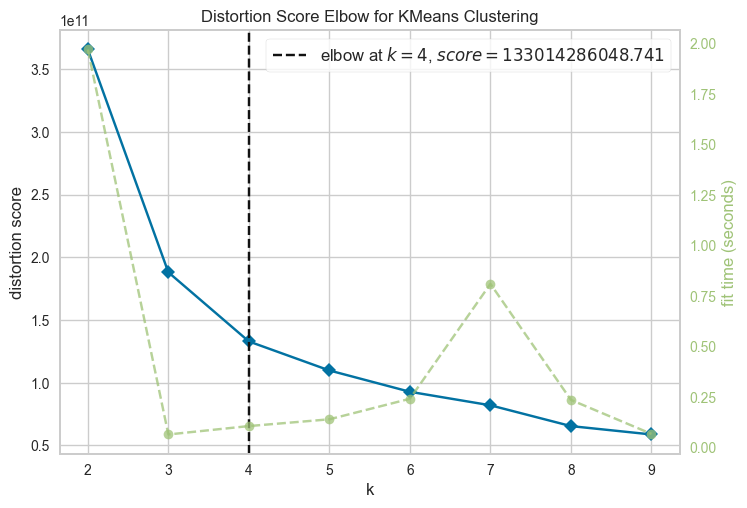

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [664]:
# Instantiate the clustering model and visualizer
km = KMeans(init="k-means++", random_state=0, n_init="auto")
visualizer = KElbowVisualizer(km, k=(2,10))
 
visualizer.fit(sum_df)        # Fit the data to the visualizer
visualizer.show()    

In [665]:
km = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=200, random_state=42)
clusters_predict = km.fit_predict(sum_df)
print(km.inertia_)

133014456515.41211


In [666]:
sum_df.shape

(27863, 16)

In [667]:
table_df.shape

(99075, 10)

In [668]:
np.unique(clusters_predict)

array([0, 1, 2, 3])

In [669]:
sum_df['cluster_label']=clusters_predict

In [670]:
sum_df = sum_df.reset_index()

In [671]:
table_df.columns

Index(['DATE', 'QUANTITY', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'RETAILER_ID', 'Week'],
      dtype='object')

In [672]:
sum_df.head()

,index,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
0,0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0,5,100.0,100.0,3
1,1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0,5,100.0,100.0,3
2,2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0,5,100.0,100.0,3
3,3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0,5,100.0,100.0,3
4,4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0,5,100.0,100.0,3


In [673]:
sum1 = 0
sum2 = 0
sum3 = 0
sum0=0


for i in range(0,len(sum_df)):

    if sum_df.loc[i,'cluster_label']==1:
        sum1=sum1+1
    
    if sum_df.loc[i,'cluster_label']==2:
        sum2= sum2+1
 
    if sum_df.loc[i,'cluster_label']==3:
        sum3= sum3+1

    if sum_df.loc[i,'cluster_label']==0:
        sum0= sum0+1


print("Cluster 0 ",sum0)
print("Cluster 1 ",sum1)
print("Cluster 2 ",sum2)
print("Cluster 3 ",sum3)



Cluster 0  12015
Cluster 1  3467
Cluster 2  498
Cluster 3  11883


In [674]:
sum_df["Landing Price"].describe()

count    27863.000000
mean        10.701650
std          2.533482
min        -45.560000
25%          9.874939
50%         10.797297
75%         11.400000
max        260.000000
Name: Landing Price, dtype: float64

Checking the goodness of fit of my clustering algorithm

In [676]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score

"""
The Davies Bouldin index is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances.
The minimum value of the DB Index is 0, whereas a smaller value (closer to 0) represents a better model that produces better clusters.
"""
print(f"Davies bouldin score: {davies_bouldin_score(sum_df,clusters_predict)}")

"""
Calinski Harabaz Index -> Variance Ratio Criterion.
Calinski Harabaz Index is defined as the ratio of the sum of between-cluster dispersion and of within-cluster dispersion.
The higher the index the more separable the clusters.
"""
print(f"Calinski Score: {calinski_harabasz_score(sum_df,clusters_predict)}")

"""
The silhouette score is a metric used to calculate the goodness of fit of a clustering algorithm, but can also be used as a method for determining an optimal value of k (see here for more).
Its value ranges from -1 to 1.
A value of 0 indicates clusters are overlapping and either the data or the value of k is incorrect.
1 is the ideal value and indicates that clusters are very dense and nicely separated.
"""
print(f"Silhouette Score: {silhouette_score(sum_df,clusters_predict)}")

Davies bouldin score: 1.160945591609031
Calinski Score: 24723.51654685991
Silhouette Score: 0.45015690831143174


In [423]:
sum_df["cluster_label"]=clusters_predict

In [424]:
sum_df.drop("index",axis=1,inplace=True)

In [425]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%',
       'cluster_label'],
      dtype='object')

In [446]:
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Assuming df is your original DataFrame
# Specify the columns you want to standardize
columns_to_standardize = ['SKU_ORDER_PRICE_AMOUNT', 'NET_SALE', 'SKU_RETURN_AMOUNT']

# Create a new DataFrame with only the columns you want to standardize
df_to_standardize = sum_df[columns_to_standardize]

# Initialize the StandardScaler
scaler = StandardScaler()

# Fit and transform the selected columns
df_standardized_values = scaler.fit_transform(df_to_standardize)

# Create a new DataFrame with the standardized values
df_standardized = pd.DataFrame(df_standardized_values, columns=columns_to_standardize)

# Concatenate the standardized DataFrame with the remaining columns from the original DataFrame
df_result = pd.concat([sum_df.drop(columns=columns_to_standardize), df_standardized], axis=1)

# Now df_result contains the original columns along with the standardized values of selected columns


In [447]:
df_result.head()

,RETAILER_ID,Week,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT
0,1.0,1,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0,5,100.0,100.0,1,-0.539511,-0.529841,-0.135583
1,1.0,2,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0,5,100.0,100.0,1,-0.155112,-0.143268,-0.135583
2,1.0,3,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0,5,100.0,100.0,1,-0.515269,-0.505463,-0.135583
3,1.0,4,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0,5,100.0,100.0,1,-0.443700,-0.433488,-0.135583
4,1.0,5,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0,5,100.0,100.0,1,-0.660717,-0.651734,-0.135583


Visualization for inference on the retailers

In [448]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='billing_week', y='total_age', color='cluster_label', labels={'biiling_week': 'billing_week'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='billing_week',
    yaxis_title='total_age',
    title='Interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


In [449]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='Activity_age', y='total_age', color='cluster_label', labels={'Activity_age': 'Activity_age'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='Activity_age',
    yaxis_title='total_age',
    title='Interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


In [450]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='ret+rep%', y='NET_SALE', color='cluster_label', labels={'ret+rep%': 'Return + Replace Percentage'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='Return + Replace Percentage',
    yaxis_title='NET_SALE',
    title='Interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()



## Cluster Analysis Results

### Cluster 0
Cluster 0, with a total of 11,899 instances, represents retailers with low net sales and negative net sale values. Additionally, this cluster exhibits high return and replacement percentages, indicating a significant number of returns and replacements.

### Cluster 1
Cluster 1, comprising 11,948 instances, is characterized by very low and negative net sale values. Similar to Cluster 0, this cluster also shows a high percentage of returns and replacements, suggesting challenges in sales performance.

### Cluster 2
Cluster 2, consisting of 407 instances, stands out with very low return and replacement percentages. However, it is associated with a high net sale, indicating a group of retailers with a positive sales trend and minimal returns.

### Cluster 3
Cluster 3, with a total of 3,327 instances, falls in the mid-range of net sales. This cluster exhibits low return and replacement percentages, suggesting a more stable and satisfactory sales performance compared to the other clusters.

These cluster descriptions provide insights into the distinct characteristics and sales patterns observed in each cluster.


In [451]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='FREQUENCY_RETAILER_WEEK', y='ret+rep%', color='cluster_label', labels={'ret+rep%': 'Return + Replace Percentage'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='FREQUENCY_RETAILER_WEEK',
    yaxis_title='Return + Replace Percentage',
    title='Interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


## Analysis of Return and Replacement Percentage vs. Retailer Frequency per Week

The second graph illustrates the relationship between the frequency of retailers per week and their corresponding return and replacement percentages. Key observations include:

- **Low Frequency Retailers (Cluster 0 and 1):**
  Retailers with lower frequency per week, primarily belonging to Cluster 0 and 1, exhibit very high return and replacement percentages. This indicates that retailers with infrequent transactions are more prone to returns and replacements, suggesting potential challenges in maintaining consistent sales.

- **High Frequency Retailers (Cluster 2 and 3):**
  On the contrary, retailers with higher frequencies per week, primarily from Cluster 2 and 3, demonstrate significantly lower return and replacement percentages. This implies that retailers with more regular and frequent transactions tend to experience fewer returns and replacements, reflecting a more stable and reliable customer base.

These insights emphasize the importance of frequency in understanding and predicting the return and replacement behavior of retailers. It suggests that fostering a consistent and frequent transaction pattern may contribute to lower return and replacement rates for retailers.


In [452]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%',
       'cluster_label'],
      dtype='object')

In [453]:
sum_df_new = sum_df[['RETAILER_ID', 
       'cluster_label']]

In [454]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='total_age', y='ret+rep%', color='cluster_label', labels={'ret+rep%': 'Return + Replace Percentage'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='total_age',
    yaxis_title='Return + Replace Percentage',
    title='Interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


In [455]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='NET_SALE', y='total_age', color='cluster_label', labels={'ret+rep%': 'Return + Replace Percentage'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='NET_SALE',
    yaxis_title='Total age in weeks interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


## Inference from Age in Weeks vs. Net Sale Plot for Cluster 1

In the "Age in Weeks vs. Net Sale" plot, Cluster 1 is positioned in the quadrant with maximum age in weeks and minimum net sales. This configuration suggests a specific retail segment characterized by:

- **Longevity in Transactions:**
  Retailers in Cluster 1 have been engaging with the platform for an extended period, as indicated by the high age in weeks. Despite their sustained presence, these retailers showcase minimal net sales.

- **Challenges in Revenue Generation:**
  The positioning of Cluster 1 in the quadrant of low net sales implies that, over their extended tenure, these retailers struggle to generate significant revenue. This could be attributed to various factors such as limited product demand, market saturation, or ineffective sales strategies.

- **Strategic Considerations:**
  For the platform or business, addressing the challenges faced by retailers in Cluster 1 may involve strategic interventions, such as targeted marketing efforts, product diversification, or personalized support to enhance their sales performance and overall contribution.

Understanding the specific characteristics of each cluster provides valuable insights for tailoring business strategies to better support and optimize the performance of retailers within the platform.


In [456]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter(sum_df, x='NET_SALE', y='FREQUENCY_RETAILER_WEEK', color='cluster_label', labels={'ret+rep%': 'Return + Replace Percentage'})

# Add axis labels and title
fig.update_layout(
    xaxis_title='NET_SALE',
    yaxis_title='FREQUENCY RETAILER WEEK',
    title='Interactive 2D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


## Inference from Frequency Retailer per Week vs. Net Sales Plot

The "Frequency Retailer per Week vs. Net Sales" plot provides valuable insights into the distribution of retailers based on their frequency and net sales, segmented by different clusters:

- **Clusters 0 and 1:**
  - **High Presence in Low Frequency:**
    Retailers in Clusters 0 and 1 dominate the low-frequency segment, indicating that a significant number of retailers in these clusters have sporadic engagement or low transactional frequency.
  - **Negative Net Sales:**
    A noteworthy observation is the prevalence of negative net sales among retailers with low frequency in Clusters 0 and 1. This suggests that a substantial portion of these retailers is not contributing positively to overall sales.

- **Clusters 2 and 3:**
  - **Decent Frequency and High Net Sales:**
    In contrast, retailers in Clusters 2 and 3 are distributed across a broader range of frequencies, including moderate to high frequency. These clusters encompass retailers who not only transact more frequently but also contribute positively to net sales, reflecting a healthier and more engaged segment.

- **Strategic Implications:**
  Understanding the distribution of retailers across clusters in the context of frequency and net sales enables strategic decision-making. Targeted interventions, such as engagement initiatives or support programs, could be devised for retailers in Clusters 0 and 1 to enhance their contribution. Conversely, retailers in Clusters 2 and 3 may be recognized as key contributors, warranting tailored incentives or recognition.

This analysis aids in identifying patterns within retailer segments, guiding strategic decisions for optimizing engagement and fostering positive sales outcomes.


In [457]:
cluster1_df = sum_df[sum_df["cluster_label"]==0]
cluster1_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
14515,4237.0,30,198.00,198.00,0.0,0.0,12.0,18.0,2,0.666667,11.000000,17,17.0,49,34.693878,34.693878,0
14525,4297.0,40,573.75,573.75,0.0,0.0,34.0,60.0,1,0.566667,9.562500,6,6.0,10,60.000000,60.000000,0
14531,4298.0,39,633.00,633.00,0.0,0.0,38.0,58.0,2,0.655172,10.913793,8,8.0,12,66.666667,66.666667,0
14532,4298.0,40,547.50,547.50,0.0,0.0,0.0,50.0,1,0.000000,10.950000,8,8.0,12,66.666667,66.666667,0
14533,4298.0,43,415.50,415.50,0.0,0.0,0.0,38.0,1,0.000000,10.934211,8,8.0,12,66.666667,66.666667,0


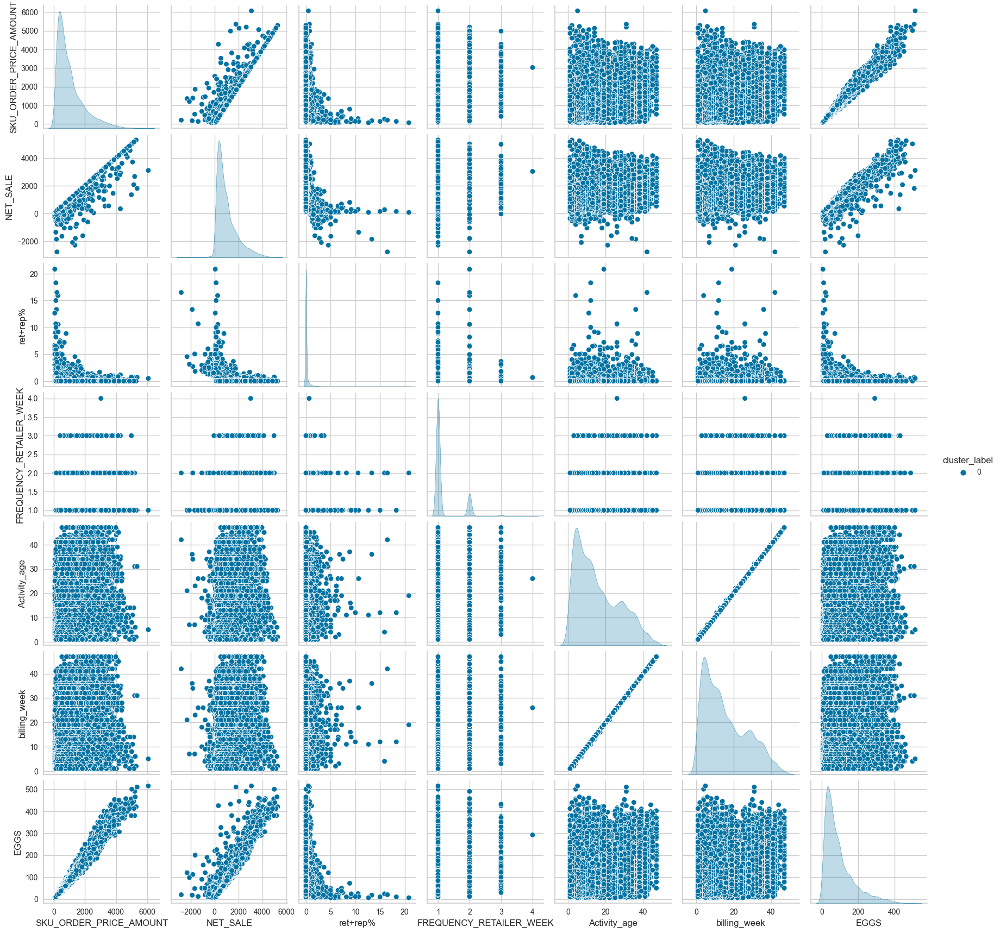

In [458]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(cluster1_df, hue='cluster_label', vars=['SKU_ORDER_PRICE_AMOUNT', 'NET_SALE','ret+rep%',"FREQUENCY_RETAILER_WEEK",'Activity_age' ,'billing_week','EGGS'])
plt.show()


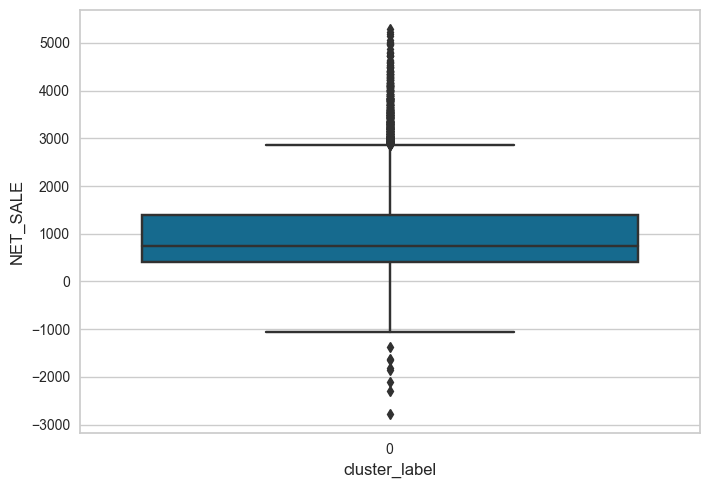

In [459]:
sns.boxplot(x='cluster_label', y='NET_SALE', data=cluster1_df)
plt.show()


In [460]:
len(cluster1_df)

12021

In [461]:
cluster1_df.describe()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
count,12021.000000,12021.0,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.000000,12021.0
mean,7152.144331,31.129191,1043.585483,1022.131307,21.454176,2.133516,8.100324,95.077198,1.173031,0.163363,11.250336,15.617586,15.607687,26.346394,60.189017,60.217458,0.0
std,1266.024533,13.798389,873.967612,870.114746,171.359943,16.662458,28.807975,82.268979,0.395282,0.675026,1.643143,11.414367,11.411053,15.972318,19.700191,19.680082,0.0
min,4237.000000,1.0,66.000000,-2782.000000,0.000000,0.000000,0.000000,6.000000,1.000000,0.000000,-44.000000,1.000000,1.000000,1.000000,3.846154,3.846154,0.0
25%,6272.000000,23.0,405.750000,400.000000,0.000000,0.000000,0.000000,36.000000,1.000000,0.000000,10.790000,6.000000,6.000000,12.000000,46.666667,46.666667,0.0
50%,7358.000000,34.0,753.750000,745.600000,0.000000,0.000000,0.000000,68.000000,1.000000,0.000000,11.014658,13.000000,13.000000,24.000000,59.574468,59.574468,0.0
75%,7902.000000,43.0,1400.000000,1386.000000,0.000000,0.000000,0.000000,126.000000,1.000000,0.000000,11.733333,24.000000,24.000000,44.000000,72.916667,72.916667,0.0
max,9911.000000,52.0,6067.500000,5288.000000,3948.000000,400.000000,638.000000,515.000000,4.000000,20.833333,57.537143,47.000000,47.000000,52.000000,100.000000,100.000000,0.0


In [445]:
cluster2_df.describe()

NameError: name 'cluster2_df' is not defined

In [ ]:
cluster3_df.describe()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
count,3352.000000,3352.0,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.000000,3352.0
mean,2981.786695,24.870525,5868.542020,5809.481823,59.060197,7.600537,40.092482,601.876492,1.730310,0.080148,9.875418,34.820107,34.819511,44.951671,77.118900,77.130833,2.0
std,2158.982703,14.620493,1792.115987,1795.676280,376.923763,50.350417,77.781810,198.725148,0.694481,0.150191,1.026048,11.165350,11.166970,10.363639,16.138687,16.148207,0.0
min,13.000000,1.0,3307.000000,1141.400000,0.000000,0.000000,0.000000,282.000000,1.000000,0.000000,-7.504175,1.000000,1.000000,1.000000,5.769231,5.769231,2.0
25%,1281.000000,13.0,4453.890000,4401.625000,0.000000,0.000000,0.000000,450.000000,1.000000,0.000000,9.239678,29.000000,29.000000,47.000000,66.666667,66.666667,2.0
50%,2478.000000,25.0,5382.000000,5332.250000,0.000000,0.000000,0.000000,546.000000,2.000000,0.000000,9.817849,38.000000,38.000000,49.000000,81.441327,81.632653,2.0
75%,4599.000000,37.0,6924.737500,6877.750000,0.000000,0.000000,50.000000,711.250000,2.000000,0.113065,10.440000,43.000000,43.000000,49.000000,89.583333,89.583333,2.0
max,9420.000000,52.0,12230.400000,10910.250000,7193.550000,1668.000000,900.000000,1362.000000,5.000000,2.349296,28.087500,49.000000,49.000000,52.000000,100.000000,100.000000,2.0


In [ ]:
cluster4_df.describe()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,cluster_label
count,412.000000,412.0,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.000000,412.0
mean,3976.026699,25.966019,15984.230534,15860.476602,123.753932,14.327670,83.640777,1672.730583,2.264563,0.059523,9.612557,38.279126,38.279126,45.580097,3.0
std,2309.088959,14.958135,5290.766169,5294.535258,556.017096,60.161558,121.122938,546.196058,0.920386,0.083645,0.888829,10.268050,10.268050,9.080119,0.0
min,56.000000,1.0,10636.050000,9655.000000,0.000000,0.000000,0.000000,866.000000,1.000000,0.000000,8.060000,1.000000,1.000000,1.000000,3.0
25%,1644.000000,14.0,12219.062500,12160.375000,0.000000,0.000000,0.000000,1300.750000,2.000000,0.000000,8.973832,37.000000,37.000000,45.000000,3.0
50%,3765.000000,28.0,14520.025000,14344.050000,0.000000,0.000000,20.000000,1508.500000,2.000000,0.024242,9.349031,39.000000,39.000000,49.000000,3.0
75%,5967.000000,38.0,17540.937500,17540.937500,0.000000,0.000000,145.000000,1900.000000,3.000000,0.093851,10.190368,44.000000,44.000000,49.000000,3.0
max,9228.000000,50.0,48867.000000,48867.000000,6390.150000,651.000000,680.000000,4700.000000,6.000000,0.532915,13.637168,49.000000,49.000000,52.000000,3.0


In [ ]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%',
       'cluster_label'],
      dtype='object')

In [462]:
cluster2_df = sum_df[sum_df["cluster_label"]==1]
cluster2_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0,5,100.0,100.0,1
1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0,5,100.0,100.0,1
2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0,5,100.0,100.0,1
3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0,5,100.0,100.0,1
4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0,5,100.0,100.0,1


In [463]:
len(cluster2_df)

12021

In [464]:
cluster3_df = sum_df[sum_df["cluster_label"]==2]
cluster3_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
55,13.0,44,4191.00,4191.00,0.0,0.0,0.0,355.0,2,0.00000,11.805634,10,10.0,19,52.631579,52.631579,2
59,15.0,4,5748.00,5748.00,0.0,0.0,75.0,595.0,4,0.12605,9.660504,42,42.0,49,85.714286,85.714286,2
78,15.0,25,8639.40,8639.40,0.0,0.0,0.0,910.0,3,0.00000,9.493846,42,42.0,49,85.714286,85.714286,2
80,15.0,27,6359.36,6359.36,0.0,0.0,0.0,664.0,3,0.00000,9.577349,42,42.0,49,85.714286,85.714286,2
84,15.0,31,8840.00,8840.00,0.0,0.0,0.0,905.0,2,0.00000,9.767956,42,42.0,49,85.714286,85.714286,2


In [465]:
len(cluster3_df)

3354

In [467]:
cluster4_df = sum_df[sum_df["cluster_label"]==3]
cluster4_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
513,56.0,49,15246.4,15246.4,0.0,0.0,0.0,1685.0,2,0.000000,9.048309,37,37.0,49,75.510204,75.510204,3
872,96.0,34,11115.0,11115.0,0.0,0.0,0.0,1060.0,2,0.000000,10.485849,41,41.0,49,83.673469,83.673469,3
874,96.0,37,13672.5,13672.5,0.0,0.0,0.0,1335.0,2,0.000000,10.241573,41,41.0,49,83.673469,83.673469,3
875,96.0,38,14977.5,14977.5,0.0,0.0,115.0,1470.0,2,0.078231,10.188776,41,41.0,49,83.673469,83.673469,3
938,102.0,21,12222.0,12222.0,0.0,0.0,0.0,1225.0,2,0.000000,9.977143,43,43.0,49,87.755102,87.755102,3


In [475]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%',
       'cluster_label'],
      dtype='object')

## Inference on individual clusters

In [468]:
import plotly.express as px

# Assuming your_dataframe has a 'cluster_label' column indicating the cluster membership
# Plot for Cluster 1
fig_cluster1 = px.scatter(cluster1_df, x='NET_SALE', y='ret+rep%',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sale', 'ret+rep%': 'Ret+Rep%'},
                          title='2D Scatter Plot for Cluster 1')

fig_cluster1.show()

fig_cluster2 = px.scatter(cluster2_df, x='NET_SALE', y='ret+rep%',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sale', 'ret+rep%': 'Ret+Rep%'},
                          title='2D Scatter Plot for Cluster 2')

fig_cluster2.show()
fig_cluster3 = px.scatter(cluster3_df, x='NET_SALE', y='ret+rep%',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sale', 'ret+rep%': 'Ret+Rep%'},
                          title='2D Scatter Plot for Cluster 3')

fig_cluster3.show()
fig_cluster4 = px.scatter(cluster4_df, x='NET_SALE', y='ret+rep%',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sale', 'ret+rep%': 'Ret+Rep%'},
                          title='2D Scatter Plot for Cluster 4')

fig_cluster4.show()

# You can customize the appearance and layout of the plots as needed


In [469]:
import plotly.express as px

# Assuming your_dataframe has a 'cluster_label' column indicating the cluster membership

# Plot for Cluster 1
fig_cluster1 = px.scatter(cluster1_df, x='Landing Price', y='total_age',
                          color='cluster_label', opacity=0.7,
                          labels={'Landing Price': 'Landing Price', 'total_age': 'Total Age'},
                          title='2D Scatter Plot for Cluster 1')

fig_cluster1.show()

# Plot for Cluster 2
fig_cluster2 = px.scatter(cluster2_df, x='Landing Price', y='total_age',
                          color='cluster_label', opacity=0.7,
                          labels={'Landing Price': 'Landing Price', 'total_age': 'Total Age'},
                          title='2D Scatter Plot for Cluster 2')

fig_cluster2.show()

# Plot for Cluster 3
fig_cluster3 = px.scatter(cluster3_df, x='Landing Price', y='total_age',
                          color='cluster_label', opacity=0.7,
                          labels={'Landing Price': 'Landing Price', 'total_age': 'Total Age'},
                          title='2D Scatter Plot for Cluster 3')

fig_cluster3.show()

# Plot for Cluster 4
fig_cluster4 = px.scatter(cluster4_df, x='Landing Price', y='total_age',
                          color='cluster_label', opacity=0.7,
                          labels={'Landing Price': 'Landing Price', 'total_age': 'Total Age'},
                          title='2D Scatter Plot for Cluster 4')

fig_cluster4.show()

# You can customize the appearance and layout of the plots as needed


In [474]:
import plotly.express as px

# Assuming your_dataframe has a 'cluster_label' column indicating the cluster membership

# Plot for Cluster 1
fig_cluster1 = px.scatter(cluster1_df, x='NET_SALE', y='FREQUENCY_RETAILER_WEEK',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sales', 'FREQUENCY_RETAILER_WEEK': 'Frequency Retailer Week'},
                          title='2D Scatter Plot for Cluster 1')

fig_cluster1.show()

# Plot for Cluster 2
fig_cluster2 = px.scatter(cluster2_df, x='NET_SALE', y='FREQUENCY_RETAILER_WEEK',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sales', 'FREQUENCY_RETAILER_WEEK': 'Frequency Retailer Week'},
                          title='2D Scatter Plot for Cluster 2')

fig_cluster2.show()

# Plot for Cluster 3
fig_cluster3 = px.scatter(cluster3_df, x='NET_SALE', y='FREQUENCY_RETAILER_WEEK',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sales', 'FREQUENCY_RETAILER_WEEK': 'Frequency Retailer Week'},
                          title='2D Scatter Plot for Cluster 3')

fig_cluster3.show()

# Plot for Cluster 4
fig_cluster4 = px.scatter(cluster4_df, x='NET_SALE', y='FREQUENCY_RETAILER_WEEK',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALE': 'Net Sales', 'FREQUENCY_RETAILER_WEEK': 'Frequency Retailer Week'},
                          title='2D Scatter Plot for Cluster 4')

fig_cluster4.show()

# You can customize the appearance and layout of the plots as needed


In [471]:
cluster1_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%',
       'cluster_label'],
      dtype='object')

In [472]:
import plotly.express as px

# Assuming your_dataframe has a 'cluster_label' column indicating the cluster membership

# Plot for Cluster 1
fig_cluster1 = px.scatter(cluster1_df, x='NET_SALE', y='billing_week',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALES': 'Net Sales', 'billing_week': 'Billing Week'},
                          title='2D Scatter Plot for Cluster 1')

fig_cluster1.show()

# Plot for Cluster 2
fig_cluster2 = px.scatter(cluster2_df, x='NET_SALE', y='billing_week',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALES': 'Net Sales', 'billing_week': 'Billing Week'},
                          title='2D Scatter Plot for Cluster 2')

fig_cluster2.show()

# Plot for Cluster 3
fig_cluster3 = px.scatter(cluster3_df, x='NET_SALE', y='billing_week',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALES': 'Net Sales', 'billing_week': 'Billing Week'},
                          title='2D Scatter Plot for Cluster 3')

fig_cluster3.show()

# Plot for Cluster 4
fig_cluster4 = px.scatter(cluster4_df, x='NET_SALE', y='billing_week',
                          color='cluster_label', opacity=0.7,
                          labels={'NET_SALES': 'Net Sales', 'billing_week': 'Billing Week'},
                          title='2D Scatter Plot for Cluster 4')

fig_cluster4.show()

# You can customize the appearance and layout of the plots as needed


In [473]:
sum_df.head()

,RETAILER_ID,Week,SKU_ORDER_PRICE_AMOUNT,NET_SALE,SKU_RETURN_AMOUNT,RETURN_EGGS,REPLACED_EGGS,EGGS,FREQUENCY_RETAILER_WEEK,ret+rep%,Landing Price,Activity_age,billing_week,total_age,billing_week%,Activity_age%,cluster_label
0,1.0,1,627.0,627.0,0.0,0.0,64.0,60.0,1,1.066667,10.450000,5,5.0,5,100.0,100.0,1
1,1.0,2,1626.0,1626.0,0.0,0.0,0.0,156.0,2,0.000000,10.423077,5,5.0,5,100.0,100.0,1
2,1.0,3,690.0,690.0,0.0,0.0,0.0,66.0,1,0.000000,10.454545,5,5.0,5,100.0,100.0,1
3,1.0,4,876.0,876.0,0.0,0.0,0.0,84.0,2,0.000000,10.428571,5,5.0,5,100.0,100.0,1
4,1.0,5,312.0,312.0,0.0,0.0,0.0,30.0,1,0.000000,10.400000,5,5.0,5,100.0,100.0,1


____________________________________________________________________________
## SVM classifier for evaluation of the clustering algorithm

In [907]:
sum_df.columns

df=sum_df[['Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'billing_week%', 'Activity_age%']]

In [908]:
from sklearn.model_selection import train_test_split

# Features (X) and Target (y)
X = df  # Features excluding the cluster label
y = sum_df['cluster_label']  # Cluster labels

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [909]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Create an SVM classifier
svm_classifier = SVC(kernel='linear', random_state=42)

# Train the classifier on the training set
svm_classifier.fit(X_train, y_train)


SVC(kernel='linear', random_state=42)

In [910]:
# Predict the cluster labels on the test set
y_pred = svm_classifier.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"Confusion Matrix:\n{conf_matrix}")
print(f"Classification Report:\n{class_report}")


Accuracy: 0.8060802302572405
Confusion Matrix:
[[1781  612   20    0]
 [ 407 1975   18    0]
 [   8    9  636    2]
 [   0    0    2   89]]
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.74      0.77      2413
           1       0.76      0.82      0.79      2400
           2       0.94      0.97      0.96       655
           3       0.98      0.98      0.98        91

    accuracy                           0.81      5559
   macro avg       0.87      0.88      0.87      5559
weighted avg       0.81      0.81      0.81      5559



In [911]:
import plotly.graph_objects as go

# Create a heatmap trace
heatmap_trace = go.Heatmap(z=conf_matrix,
                          x=svm_classifier.classes_,
                          y=svm_classifier.classes_,
                          colorscale='Blues',
                          colorbar=dict(title='Count'))

# Create the layout
layout = go.Layout(title='Confusion Matrix',
                   xaxis=dict(title='Predicted Label'),
                   yaxis=dict(title='True Label'))

# Create the figure and show
fig = go.Figure(data=[heatmap_trace], layout=layout)
fig.show()


----------------------
End of segmentation----------------------------------------------------------

ignore the code below

In [698]:
sum_df.columns

Index(['RETAILER_ID', 'Week', 'SKU_ORDER_PRICE_AMOUNT', 'NET_SALE',
       'SKU_RETURN_AMOUNT', 'RETURN_EGGS', 'REPLACED_EGGS', 'EGGS',
       'FREQUENCY_RETAILER_WEEK', 'ret+rep%', 'Landing Price', 'Activity_age',
       'billing_week', 'total_age', 'cluster_label'],
      dtype='object')

In [699]:
import pandas as pd
import plotly.express as px

# Assuming sum_df is your DataFrame
fig = px.scatter_3d(sum_df, x='NET_SALE', y='REPLACED_EGGS', z='RETURN_EGGS', color='cluster_label', labels={'ret+rep%': 'Return + Replace Percentage'})

# Add axis labels and title
fig.update_layout(
    scene=dict(
        xaxis_title='NET_SALE',
        yaxis_title='Replaced Eggs',
        zaxis_title='Returned Eggs',
    ),
    title='Interactive 3D Plot with Cluster Index'
)

# Show the interactive plot
fig.show()


STATISTICS ON THE NET_SALE AND RETURN_REPLACEMENT% COLUMNS FOR EACH CLUSTER

In [1043]:
sum_df[sum_df["cluster_label"]==3][['ret+rep%','NET_SALE']].describe()

,ret+rep%,NET_SALE
count,6262.000000,6262.000000
mean,0.093498,3299.013937
std,0.188459,951.818920
min,0.000000,2059.500000
25%,0.000000,2478.150000
50%,0.000000,3055.950000
75%,0.121363,3976.000000
max,2.592885,5582.500000


In [1044]:
sum_df[sum_df["cluster_label"]==0][['ret+rep%','NET_SALE']].describe()

,ret+rep%,NET_SALE
count,19184.000000,19184.000000
mean,0.212846,857.578740
std,0.710805,544.044006
min,0.000000,-2924.000000
25%,0.000000,422.400000
50%,0.000000,751.500000
75%,0.048000,1239.000000
max,20.833333,2080.800000


In [1045]:
sum_df[sum_df["cluster_label"]==1][['ret+rep%','NET_SALE']].describe()

,ret+rep%,NET_SALE
count,1601.000000,1601.000000
mean,0.067671,7859.033459
std,0.130154,1877.321635
min,0.000000,5579.400000
25%,0.000000,6293.000000
50%,0.000000,7377.500000
75%,0.097561,8985.520000
max,2.349296,12994.000000


In [1046]:
sum_df[sum_df["cluster_label"]==2][['ret+rep%','NET_SALE']].describe()

,ret+rep%,NET_SALE
count,252.000000,252.000000
mean,0.054315,18247.783889
std,0.069109,5409.088526
min,0.000000,13104.000000
25%,0.000000,14618.450000
50%,0.027395,16586.700000
75%,0.088520,19644.762500
max,0.360457,48867.000000


END OF CUSTOMER SEGMENTATION

In [404]:
def get_pca_2d(df, predict):

    pca_2d_object = prince.PCA(
    n_components=2,
    n_iter=3,
    rescale_with_mean=True,
    rescale_with_std=True,
    copy=True,
    check_input=True,
    engine='sklearn',
    random_state=42
    )

    pca_2d_object.fit(df)

    df_pca_2d = pca_2d_object.transform(df)
    df_pca_2d.columns = ["comp1", "comp2"]
    df_pca_2d["cluster"] = predict

    return pca_2d_object, df_pca_2d



def get_pca_3d(df, predict):

    pca_3d_object = prince.PCA(
    n_components=3,
    n_iter=3,
    rescale_with_mean=True,
    rescale_with_std=True,
    copy=True,
    check_input=True,
    engine='sklearn',
    random_state=42
    )

    pca_3d_object.fit(df)

    df_pca_3d = pca_3d_object.transform(df)
    df_pca_3d.columns = ["comp1", "comp2", "comp3"]
    df_pca_3d["cluster"] = predict

    return pca_3d_object, df_pca_3d



def plot_pca_3d(df, title = "PCA Space", opacity=0.8, width_line = 0.1):

    df = df.astype({"cluster": "object"})
    df = df.sort_values("cluster")

    columns = df.columns[0:3].tolist()

    fig = px.scatter_3d(df, 
                        x=columns[0], 
                        y=columns[1], 
                        z=columns[2],
                        color='cluster',
                        template="plotly",
                        
                        # symbol = "cluster",
                        
                        color_discrete_sequence=px.colors.qualitative.Vivid,
                        title=title).update_traces(
                            # mode = 'markers',
                            marker={
                                "size": 4,
                                "opacity": opacity,
                                # "symbol" : "diamond",
                                "line": {
                                    "width": width_line,
                                    "color": "black",
                                }
                            }
                        ).update_layout(
                                width = 1000, 
                                height = 800, 
                                autosize = False, 
                                showlegend = True,
                                legend=dict(title_font_family="Times New Roman",
                                            font=dict(size= 20)),
                                scene = dict(xaxis=dict(title = 'comp1', titlefont_color = 'black'),
                                            yaxis=dict(title = 'comp2', titlefont_color = 'black'),
                                            zaxis=dict(title = 'comp3', titlefont_color = 'black')),
                                font = dict(family = "Gilroy", color  = 'black', size = 15))
                      
    
    fig.show()


def plot_pca_2d(df, title = "PCA Space", opacity=0.8, width_line = 0.1):

    df = df.astype({"cluster": "object"})
    df = df.sort_values("cluster")

    columns = df.columns[0:3].tolist()


    fig = px.scatter(df, 
                        x=columns[0], 
                        y=columns[1],
                        color='cluster',
                        template="plotly",
                        # symbol = "cluster",
                        
                        color_discrete_sequence=px.colors.qualitative.Vivid,
                        title=title).update_traces(
                            # mode = 'markers',
                            marker={
                                "size": 8,
                                "opacity": opacity,
                                # "symbol" : "diamond",
                                "line": {
                                    "width": width_line,
                                    "color": "black",
                                }
                            }
                        ).update_layout(
                                width = 800, 
                                height = 700, 
                                autosize = False, 
                                showlegend = True,
                                legend=dict(title_font_family="Times New Roman",
                                            font=dict(size= 20)),
                                scene = dict(xaxis=dict(title = 'comp1', titlefont_color = 'black'),
                                            yaxis=dict(title = 'comp2', titlefont_color = 'black'),
                                            ),
                                font = dict(family = "Gilroy", color  = 'black', size = 15))
                        
        
    fig.show()


In [405]:
pca_3d_object, df_pca_3d = get_pca_3d(df_new, clusters_predict)
plot_pca_3d(df_pca_3d, title = "PCA Space", opacity=1, width_line = 0.1)

In [406]:

print("The variability is :", pca_3d_object.eigenvalues_summary)

The variability is :           eigenvalue % of variance % of variance (cumulative)
component                                                    
0              3.916        13.05%                     13.05%
1              2.393         7.98%                     21.03%
2              2.036         6.79%                     27.82%


In [407]:
sampling_data = df_new.sample(frac=0.5, replace=True, random_state=1)
sampling_clusters = pd.DataFrame(clusters_predict).sample(frac=0.5, replace=True, random_state=1)[0].values

df_tsne_3d = TSNE(
                  n_components=3, 
                  learning_rate=700, 
                  init='random', 
                  perplexity=100, 
                  n_iter = 500).fit_transform(sampling_data)



In [409]:
df_tsne_3d = pd.DataFrame(df_tsne_3d, columns=["comp1", "comp2",'comp3'])


In [410]:
df_tsne_3d["cluster"] = sampling_clusters


In [504]:
table_df_new.shape

NameError: name 'table_df_new' is not defined

In [412]:
sampling_clusters.shape

(48473,)

In [413]:
plot_pca_3d(df_tsne_3d, title = "PCA Space", opacity=1, width_line = 0.1)

K-Prototype

In [27]:
import pandas as pd # dataframe manipulation
import numpy as np # linear algebra

# data visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import shap

# sklearn 
from sklearn.cluster import KMeans
from sklearn.preprocessing import PowerTransformer, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, silhouette_samples, accuracy_score, classification_report

from pyod.models.ecod import ECOD
from yellowbrick.cluster import KElbowVisualizer

import lightgbm as lgb
import prince

from kmodes.kprototypes import KPrototypes
from plotnine import *
import plotnine

In [2]:
'''!pip install pyod
!pip install yellowbrick
!pip install lightgbm
!pip install prince
!pip install kmodes
!pip install plotnine'''

Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/160.5 kB ? eta -:--:--
     ------- ------------------------------- 30.7/160.5 kB 1.4 MB/s eta 0:00:01
     ------- ------------------------------- 30.7/160.5 kB 1.4 MB/s eta 0:00:01
     --------------------- --------------- 92.2/160.5 kB 655.4 kB/s eta 0:00:01
     ------------------------- ---------- 112.6/160.5 kB 547.6 kB/s eta 0:00:01
     ---------------------------------- - 153.6/160.5 kB 706.2 kB/s eta 0:00:01
     ---------------------------------- - 153.6/160.5 kB 706.2 kB/s eta 0:00:01
     ------------------------------------ 160.5/160.5 kB 506.1 kB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for pyod: filename=pyod-1.1.2-py3-none-any.whl size=190452 sha256=720eaf0121afc2a680c8d5a7c178e3cebd83029269acbcb7075690bd0665a961
  Stored in directory: c:\users\user\app


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/282.6 kB ? eta -:--:--
     ---- ---------------------------------- 30.7/282.6 kB 1.3 MB/s eta 0:00:01
     ----- ------------------------------- 41.0/282.6 kB 960.0 kB/s eta 0:00:01
     ------------ ------------------------ 92.2/282.6 kB 744.7 kB/s eta 0:00:01
     -------------- --------------------- 112.6/282.6 kB 819.2 kB/s eta 0:00:01
     ---------------------- ------------- 174.1/282.6 kB 807.1 kB/s eta 0:00:01
     ---------------------- ------------- 174.1/282.6 kB 807.1 kB/s eta 0:00:01
     -----------------------------------  276.5/282.6 kB 896.4 kB/s eta 0:00:01
     -----------------------------------  276.5/282.6 kB 896.4 kB/s eta 0:00:01
     -----------------------------------  276.5/282.6 kB 896.4 kB/s eta 0:00:01
     -----------------------------------  276.5/282.6 kB 896.4 kB/s eta 0:00:01
     -----------------------------------  276.5/2


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
     -- ------------------------------------- 0.1/1.3 MB 1.5 MB/s eta 0:00:01
     -- ------------------------------------- 0.1/1.3 MB 1.7 MB/s eta 0:00:01
     ---- ----------------------------------- 0.2/1.3 MB 1.1 MB/s eta 0:00:02
     ----- ---------------------------------- 0.2/1.3 MB 876.1 kB/s eta 0:00:02
     ------- -------------------------------- 0.3/1.3 MB 1.1 MB/s eta 0:00:02
     -------- ------------------------------- 0.3/1.3 MB 1.1 MB/s eta 0:00:01
     ---------- ----------------------------- 0.3/1.3 MB 1.1 MB/s eta 0:00:01
     ----------- ---------------------------- 0.4/1.3 MB 1.0 MB/s eta 0:00:01
     -------------- ------------------------- 0.5/1.3 MB 1.1 MB/s eta 0:00:01
     -------------- ------------------------- 0.5/1.3 MB 1.0 MB/s eta 0:00:01
     --------------- ------------------------ 0.5/1.3 MB 1.0 MB/s eta


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/415.6 kB ? eta -:--:--
      --------------------------------------- 10.2/415.6 kB ? eta -:--:--
     --- --------------------------------- 41.0/415.6 kB 653.6 kB/s eta 0:00:01
     --- --------------------------------- 41.0/415.6 kB 653.6 kB/s eta 0:00:01
     --------- -------------------------- 112.6/415.6 kB 930.9 kB/s eta 0:00:01
     --------- -------------------------- 112.6/415.6 kB 930.9 kB/s eta 0:00:01
     --------------- -------------------- 174.1/415.6 kB 871.5 kB/s eta 0:00:01
     ----------------- ------------------ 204.8/415.6 kB 731.4 kB/s eta 0:00:01
     -------------------------- --------- 307.2/415.6 kB 999.9 kB/s eta 0:00:01
     -------------------------- --------- 307.2/415.6 kB 999.9 kB/s eta 0:00:01
     -------------------------------------  409.6/415.6 kB 1.1 MB/s eta 0:00:01
     -------------------------------------  409.6/415.6


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
      --------------------------------------- 0.0/1.3 MB ? eta -:--:--
     -- ------------------------------------- 0.1/1.3 MB 1.1 MB/s eta 0:00:02
     --- ------------------------------------ 0.1/1.3 MB 1.1 MB/s eta 0:00:02
     ---- ----------------------------------- 0.2/1.3 MB 1.0 MB/s eta 0:00:02
     ----- ---------------------------------- 0.2/1.3 MB 952.6 kB/s eta 0:00:02
     -------- ------------------------------- 0.3/1.3 MB 1.1 MB/s eta 0:00:01
     ---------- ----------------------------- 0.3/1.3 MB 1.1 MB/s eta 0:00:01
     -------------- ------------------------- 0.5/1.3 MB 1.3 MB/s eta 0:00:01
     ---------------- ----------------------- 0.5/1.3 MB 1.4 MB/s eta 0:00:01
     --------------------- ------------------ 0.7/1.3 MB 1.5 MB/s eta 0:00:01
     ---------------------- ----------------- 0.7/1.3 MB 1.6 MB/s eta 0:00:0


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
!pip install shap

Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 0.0/447.3 kB ? eta -:--:--
     ---------- ----------------------------- 122.9/447.3 kB ? eta -:--:--
     ---------------- --------------------- 194.6/447.3 kB 2.4 MB/s eta 0:00:01
     ----------------- -------------------- 204.8/447.3 kB 1.8 MB/s eta 0:00:01
     --------------------- ---------------- 256.0/447.3 kB 1.4 MB/s eta 0:00:01
     -------------------------- ----------- 317.4/447.3 kB 1.6 MB/s eta 0:00:01
     -------------------------- ----------- 317.4/447.3 kB 1.6 MB/s eta 0:00:01
     --------------------------------- ---- 399.4/447.3 kB 1.3 MB/s eta 0:00:01
     -------------------------------------  440.3/447.3 kB 1.3 MB/s eta 0:00:01
     -------------------------------------  440.3/447.3 kB 1.3 MB/s eta 0:00:01
     -------------------------------------  440.3/447.3 kB 1.3 MB/s eta 0:00:01
     -------------------------------------  440.3/447.


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [28]:
table_df = table_df.iloc[:,:]

In [29]:

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OrdinalEncoder


pipe = Pipeline([('ordinal', OrdinalEncoder()), ('scaler', PowerTransformer())])
pipe_fit = pipe.fit(table_df)

data = pd.DataFrame(pipe_fit.transform(table_df), columns = table_df.columns)
data

,RETAILER_NAME,DATE,QUANTITY,SKU_ORDER_PRICE_AMOUNT,NET_SALE,AREA_CLASSIFICATION,BEAT_NUMBER,SKU_RETURN_AMOUNT,SKU_COUNT,SHORT_NAME,SKU,PRODUCT_TYPE,RETURN_EGGS,REPLACED_EGGS,PROMO_EGGS,SINGLE_SKU_RATE,EGGS,RETAILER_CATEGORY,SALE_TYPE,RETAILER_ID
0,0.944682,-1.495324,-1.661087,-1.776758,-1.399109,1.722972,2.112411,-0.178808,-1.457706,0.632711,1.420473,0.0,-0.186068,1.444932,-0.151841,-1.712718,-1.665964,0.0,0.598868,-0.498114
1,1.519492,0.605857,-1.661087,-1.776758,-1.716918,1.722972,0.552620,5.592637,-0.064651,-1.585701,-1.673756,0.0,5.374384,-0.519031,-0.151841,-1.712718,-1.665964,0.0,0.598868,0.089427
2,1.261227,-1.287725,-1.661087,-1.776758,-1.399109,1.093330,1.504511,-0.178808,-1.457706,0.632711,1.420473,0.0,-0.186068,1.937302,-0.151841,-1.712718,-1.665964,0.0,-1.669818,0.966512
3,-0.198418,0.536735,-0.890637,-1.400872,-1.185299,-0.457943,0.458530,-0.178808,-1.457706,0.632711,1.420473,0.0,-0.186068,1.444932,-0.151841,-0.719607,-1.249045,0.0,-1.669818,1.413874
4,-0.271921,0.682890,-0.404205,-0.453964,-1.399109,-0.457943,0.290678,5.592637,-0.064651,0.632711,-0.468810,0.0,5.374385,1.777697,-0.151841,0.410191,-0.439623,0.0,-1.669818,1.257168
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96729,-1.160669,-0.632542,-0.042014,0.816106,0.831024,-0.457943,0.219040,-0.178808,1.228428,-1.585701,-0.053022,0.0,-0.186068,-0.519031,-0.151841,1.228985,0.709957,0.0,-1.669818,-1.005154
96730,0.765337,0.876477,-0.890637,-0.805491,-0.887267,-0.017711,-1.285174,-0.178808,-0.064651,-1.585701,-1.673756,0.0,-0.186068,-0.519031,-0.151841,0.679002,-0.973302,0.0,0.598868,1.337657
96731,-0.552072,-1.868076,-0.042014,-0.049477,-0.198943,-0.457943,0.026137,-0.178808,-0.064651,0.632711,-0.468810,0.0,-0.186068,-0.519031,-0.151841,0.423493,-0.086656,0.0,-1.669818,0.703442
96732,0.499644,1.385955,-0.042014,0.715129,0.697670,-0.017711,-0.905842,-0.178808,1.228428,0.632711,0.304955,0.0,-0.186068,-0.519031,-0.151841,1.087264,0.709957,0.0,0.598868,-0.133573


In [867]:
'''from pyod.models.ecod import ECOD
# https://github.com/yzhao062/pyod
clf = ECOD()
clf.fit(data)
outliers = clf.predict(data) 

table_df["outliers"] = outliers

df_no_outliers = table_df[table_df["outliers"] == 0]
df_no_outliers = df_no_outliers.drop(["outliers"], axis = 1)'''

'from pyod.models.ecod import ECOD\n# https://github.com/yzhao062/pyod\nclf = ECOD()\nclf.fit(data)\noutliers = clf.predict(data) \n\ntable_df["outliers"] = outliers\n\ndf_no_outliers = table_df[table_df["outliers"] == 0]\ndf_no_outliers = df_no_outliers.drop(["outliers"], axis = 1)'

In [868]:
#df_no_outliers

In [866]:
'''pipe = Pipeline([('scaler', PowerTransformer())])

df_aux = pd.DataFrame(pipe_fit.fit_transform(df_no_outliers[["age", "balance"]] ), columns = ["age", "balance"])
df_no_outliers_norm = df_no_outliers.copy()

# Replace age and balance columns by preprocessed values
df_no_outliers_norm = df_no_outliers_norm.drop(["age", "balance"], axis = 1)
df_no_outliers_norm["age"] = df_aux["age"].values
df_no_outliers_norm["balance"] = df_aux["balance"].values
df_no_outliers_norm'''

'pipe = Pipeline([(\'scaler\', PowerTransformer())])\n\ndf_aux = pd.DataFrame(pipe_fit.fit_transform(df_no_outliers[["age", "balance"]] ), columns = ["age", "balance"])\ndf_no_outliers_norm = df_no_outliers.copy()\n\n# Replace age and balance columns by preprocessed values\ndf_no_outliers_norm = df_no_outliers_norm.drop(["age", "balance"], axis = 1)\ndf_no_outliers_norm["age"] = df_aux["age"].values\ndf_no_outliers_norm["balance"] = df_aux["balance"].values\ndf_no_outliers_norm'